# **Lista 2 de Processamento de Imagens**

Professora: Mylene Farias

Aluna: Daniele Dias

matrícula: 20/0081691

---

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import os
# Check current working directory.
print(os.getcwd())
os.chdir('/content/drive/MyDrive/processamento_imagens/Lista 02')
# Check current working directory.
print(os.getcwd())

Mounted at /content/drive
/content
/content/drive/MyDrive/processamento_imagens/Lista 02



# Global da Lista

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from scipy import ndimage
import itertools
import math

#####################################
########## my functions  ############
#####################################

# item 1.1
def cdfSum(hist):
  #The Python iter() function returns an iterator for the given object.
  hist = iter(hist)
  b = [next(hist)]
  for i in hist:
      b.append(b[-1] + i)
  cdf = np.array(b)

  # Normalization
  nj = (cdf - cdf.min()) * 255
  N = cdf.max() - cdf.min()
  if N == 0:
    cdfNormalizated = np.zeros(len(b))
  # re-normalize the cdf
  else:
    cdfNormalizated = nj / N
  return cdfNormalizated

#item 1.2
#Using example 3.12 3rd edition of book
def localHistEqualization(img, k0, k1, k2, n):
  #Parameter of the image
  x,y= img.shape
  x = x-n+1
  y= y-n+1
  #Allocating memory
  newImage = np.zeros((x, y))
  #Calculate the histogram of the image
  hist1, bins1 = np.histogram(img, 256, [0,256])
  #Calculate its cdf
  cdfImg = cdfSum(hist1)
  #Global mean
  meang = cdfImg.mean()
  #Global standard deviation
  stdg = cdfImg.std()
  for i in range(x):
    for j in range(y):
      #Determine the neighbors
      neighbors = img[i+2:(i+n+2), j+2:(j+n+2)]
      #Calculate the histogram
      hist, bins = np.histogram(neighbors.ravel(), 256, [0,256])
      #Calculate the cdf
      cdf = cdfSum(hist)
      meanSxy = hist.mean()
      stdSxy = hist.std()
      #Determine the new value of the image
      if meanSxy < (k0*meang) and stdSxy > (k1*stdg) and stdSxy < (k2*stdg):
        centerLevel = img[i][j]
        newPixelValue = cdf[centerLevel]
        newImage[i][j] = newPixelValue
      else:
        centerLevel = img[i][j]
        newImage[i][j] = centerLevel
  return newImage

#item 1.3
#Histogram Matching
def histMatch(source, template):
    #Parameters of the images
    oldShape = source.shape
    source = source.ravel()
    template = template.ravel()
    #Calculate the cdf of images
    histSource, binsSource = np.histogram(source, 256, [0,256])
    histTemplate, binsTemplate = np.histogram(template, 256, [0,256])
    cdfSource = cdfSum(histSource)
    cdfTemplate = cdfSum(histTemplate)
    #Return evenly spaced values within a given interval.
    pixels = np.arange(256)
    # find closest pixel-matches corresponding to the CDF of the input image, given the value of the CDF H of   
    # the template image at the corresponding pixels
    newPixels = np.interp(cdfSource, cdfTemplate, pixels) 
    outImage = (np.reshape(newPixels[source], oldShape)).astype(np.uint8)
    return outImage

#item 1.2
def localHistEqualizationSimple(img, n):
  #Parameter of the image
  x,y= img.shape
  x = x-n+1
  y= y-n+1
  #Allocating memory
  newImage = np.zeros((x, y))

  for i in range(x):
    for j in range(y):
      #Determine the neighbors
      neighbors = img[i+2:(i+n+2), j+2:(j+n+2)]
      #Calculate the histogram
      hist, bins = np.histogram(neighbors.ravel(), 256, [0,256])
      #Calculate the cdf
      cdf = cdfSum(hist)
      #Determine the new value of the image
      centerLevel = img[i][j]
      newPixelValue = cdf[centerLevel]
      newImage[i][j] = newPixelValue
  return newImage


#item 2.1
def convolution2d(image, kernel):
  #parameters of the filter and image
  m, n = kernel.shape
  x, y = image.shape
  #Define the range of the image
  y = y - m + 1
  x = x - m + 1
  #Allocating memory
  newImage = np.zeros((y,x))
  for i in range(x):
    for j in range(y):
      #Convolution with rotated filter in 180°
      newImage[i][j] = np.sum(image[i:i+m, j:j+m]*kernel[::-1])
  #Normalized Image
  nj = (newImage - newImage.min()) * 255
  N = newImage.max() - newImage.min()
  #Output
  newImage = nj / N
  return newImage

#item 2.2
def laplacian2d(image, kernel,*c):
  #sharpening constant default
  if not c:
    c = 1
  #parameters of the filter and kernel
  m, n = kernel.shape
  x, y = image.shape
  #Define the range of the image
  y = y - m + 1
  x = x - m + 1
  #Allocating memory
  if x == y:
    newImage = np.zeros((x,y))
    newImageAdjusted = np.zeros((x,y))
    filterImage = np.zeros((x,y))
  else:
    newImage = np.zeros(image.shape)
    newImageAdjusted = np.zeros(image.shape)
    filterImage = np.zeros(image.shape)
  for i in range(x):
    for j in range(y):
      #Convolution with filter
      value = np.sum(image[i:i+m, j:j+m]*kernel[::-1])
      #Adjusting to see the borders better
      newImage[i][j] = min(255, max(0, value))
      #Laplacian Filter
      newImageAdjusted[i][j] = value
      #Sharp Image
      filterImage[i][j] = np.sum(image[i:i+m, j:j+m] + c*image[i:i+m, j:j+m]*kernel[::-1])
  #Normalized Image
  nj1 = (newImageAdjusted - newImageAdjusted.min()) * 255
  N1 = newImageAdjusted.max() - newImageAdjusted.min()
  newImageAdjusted = nj1 / N1

  nj = (filterImage - filterImage.min()) * 255
  N = filterImage.max() - filterImage.min()
  filterImage = nj / N
  return newImage, newImageAdjusted, filterImage

#item 2.3
def unsharpMasking(image, kernel, k):
  #parameters of the filter and kernel
  m, n = kernel.shape
  x, y = image.shape
  #Define the range of the image
  y = y - m + 1
  x = x - m + 1
  #Blurred image
  newImage = convolution2d(image,kernel)
  #Allocating memory
  result = np.zeros((x,y))
  g = np.zeros((x,y))
  for i in range(x):
    for j in range(y):
      #Unsharping Mask
      g[i][j] = image[i][j] - newImage[i][j]
      #High-Boost Filter
      result[i][j] = image[i][j] + k*g[i][j]
  #Normalized Image
  nj1 = (g - g.min()) * 255
  N1 = g.max() - g.min()
  g = nj1 / N1

  nj = (result - result.min()) * 255
  N = result.max() - result.min()
  result = nj / N
  return newImage, g, result

############ item 3.1############

def distance(point1,point2):
  #distance between a point (u, v) in the frequency domain and the center of the frequency rectangle (Spectrum)
  return math.sqrt((point1[0]-point2[0])**2 + (point1[1]-point2[1])**2)

def idealFilterLP(D0,imgShape):
  #parameters of the image
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
          #D0 is the distance to cutoff frequency 
            if distance((y,x),center) < D0:
                base[y,x] = 1
    return base

def gaussianLP(D0,imgShape):
  #parameters of the image
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
          #D0 is the distance to cutoff frequency 
            base[y,x] = math.exp(((-distance((y,x),center)**2)/(2*(D0**2))))
    return base

def butterworthLP(D0,imgShape,n):
  #parameters of the image
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
          #D0 is the distance to cutoff frequency and n is the order of filter
            base[y,x] = 1/(1+(distance((y,x),center)/D0)**(2*n))
    return base

############ item 3.2############
def idealFilterHP(D0,imgShape):
  #parameters of the image
    base = np.ones(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
          #D0 is the distance to cutoff frequency 
            if distance((y,x),center) < D0:
                base[y,x] = 0
    return base

def gaussianHP(D0,imgShape):
  #parameters of the image
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
          #D0 is the distance to cutoff frequency 
            base[y,x] = 1 - math.exp(((-distance((y,x),center)**2)/(2*(D0**2))))
    return base

def butterworthHP(D0, imgShape, n):
  #parameters of the image
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
          #D0 is the distance to cutoff frequency and n is the order of filter
            base[y,x] = 1-1/(1+(distance((y,x),center)/D0)**(2*n))
    return base

###########item 3.3###################

def unsharpMaskingFourierLP(center, filterCenter, k):
  #high-boost Low Pass Fourier Domain
  highBoostFrequencyC = center + k*(center -  filterCenter)
  highBoostFrequency = np.fft.ifftshift(highBoostFrequencyC)
  #high-boost Low Pass spatial Domain
  inverseHighBoost = np.fft.ifft2(highBoostFrequency)
  return inverseHighBoost

def unsharpMaskingFourierHP(center, filterCenter, k):
  #high-boost High Pass Fourier Domain
  highBoostFrequencyC = center + k*filterCenter
  highBoostFrequency = np.fft.ifftshift(highBoostFrequencyC)
  #high-boost High Pass spatial Domain
  inverseHighBoost = np.fft.ifft2(highBoostFrequency)
  return inverseHighBoost

>Este Bloco contém todas as imagens para a reaização do trabalho

(<matplotlib.axes._subplots.AxesSubplot at 0x7f1ae9ef3f90>,
 Text(0.5, 1.0, 'Zelda'))

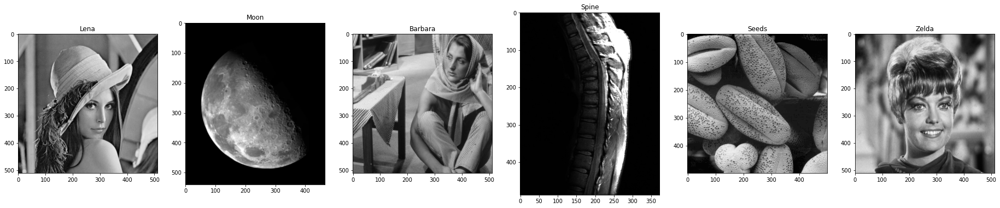

In [ ]:
#Images
lena = cv2.imread('lena.bmp',0) # pass 0 to read grayscale image
lua = cv2.imread('Lua.tif',0)
barbara = cv2.imread('barbara.png',0)
coluna = cv2.imread('coluna.png',0)
semente = cv2.imread('sementes.png',0)
zelda = cv2.imread('zelda.png',0)
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)
plt.subplot(161), plt.imshow(lena,cmap=plt.cm.gray), plt.title("Lena")
plt.subplot(162), plt.imshow(lua,cmap=plt.cm.gray), plt.title("Moon")
plt.subplot(163), plt.imshow(barbara,cmap=plt.cm.gray), plt.title("Barbara")
plt.subplot(164), plt.imshow(coluna,cmap=plt.cm.gray), plt.title("Spine")
plt.subplot(165), plt.imshow(semente,cmap=plt.cm.gray), plt.title("Seeds")
plt.subplot(166), plt.imshow(zelda,cmap=plt.cm.gray), plt.title("Zelda")

# Parte 1

**Equalização**

## 1.1 - Equalização de Histograma Global pela CDF

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7cee276310>,
 <BarContainer object of 256 artists>,
 Text(0.5, 1.0, 'Moon Histogram'))

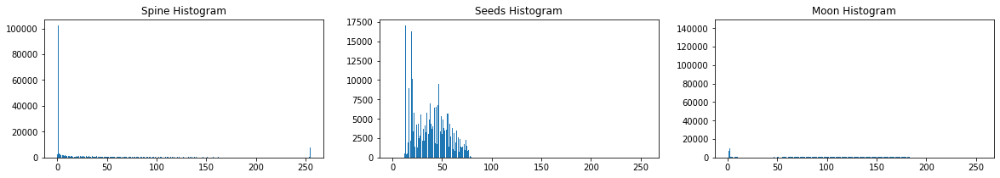

In [ ]:
# Histogram of Spine
histColuna, binsColuna = np.histogram(coluna.ravel(), 256, [0,256])
histColuna.shape, binsColuna.shape

# Histogram of Seeds
histSemente, binsSemente = np.histogram(semente.ravel(), 256, [0,256])
histSemente.shape, binsSemente.shape

# Histogram of Moon
histLua, binsLua = np.histogram(lua.ravel(), 256, [0,256])
histColuna.shape, binsColuna.shape

#plots
plt.figure(figsize=(20, 3), constrained_layout=False)
plt.subplot(131),plt.bar(range(len(histColuna)), histColuna),plt.title("Spine Histogram")
plt.subplot(132),plt.bar(range(len(histSemente)), histSemente),plt.title("Seeds Histogram")
plt.subplot(133),plt.bar(range(len(histLua)), histLua),plt.title("Moon Histogram")

> Para realizar a equaização global, foi utilizada a função *cdfSum*, que calcula a função de distribuição acumulativa de cada imagem e normaliza para valores entre 0 e 255. Para essa função é necessário somente o histograma da imagem.

> Logo após esse procedimento, cada valor dessa cdf é distribuído na sua imagem original, finalizando o procedimento de equalização global.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7cf00284d0>,
 Text(0.5, 1.0, 'Seeds Equalizared'))

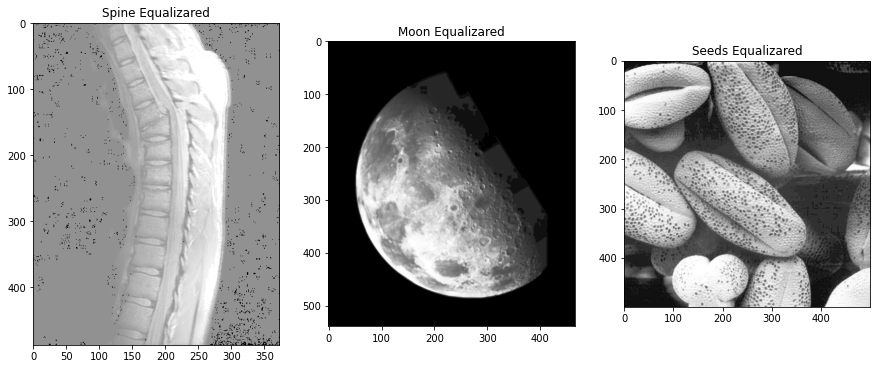

In [ ]:
# execute the cdf function
cdfSpine = cdfSum(histColuna)
cdfMoon = cdfSum(histLua)
cdfSeeds = cdfSum(histSemente)

# get the value from cumulative sum for every index of image
spineNew = cdfSpine[coluna.ravel()]
moonNew = cdfMoon[lua.ravel()]
seedsNew = cdfSeeds[semente.ravel()]

# put array back into original shape since we flattened it
spineNew = np.reshape(spineNew, coluna.shape)
moonNew = np.reshape(moonNew, lua.shape)
seedsNew = np.reshape(seedsNew, semente.shape)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(131), plt.imshow(spineNew,cmap=plt.cm.gray), plt.title("Spine Equalizared")
plt.subplot(132), plt.imshow(moonNew,cmap=plt.cm.gray), plt.title("Moon Equalizared")
plt.subplot(133), plt.imshow(seedsNew,cmap=plt.cm.gray), plt.title("Seeds Equalizared")

## 1.2 - Equalização por Histograma Local

>Fazendo com uma função mais simples de Equalização Local.

> Assim como feito com a equalização global, eu utilizo a função *cdfSum*, porém para a Equalização Local é utilizado a função *localHistEqualizationSimple*, que aplica a função cdfSum em janelas que percorrem a imagem, de tamanhos 5x5 ou 7x7. Para essa função só é necessário mandar a imagem e o valor da janela necessária.


(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ced8dcfd0>,
 Text(0.5, 1.0, 'Spine Local Equalization with 7x7'))

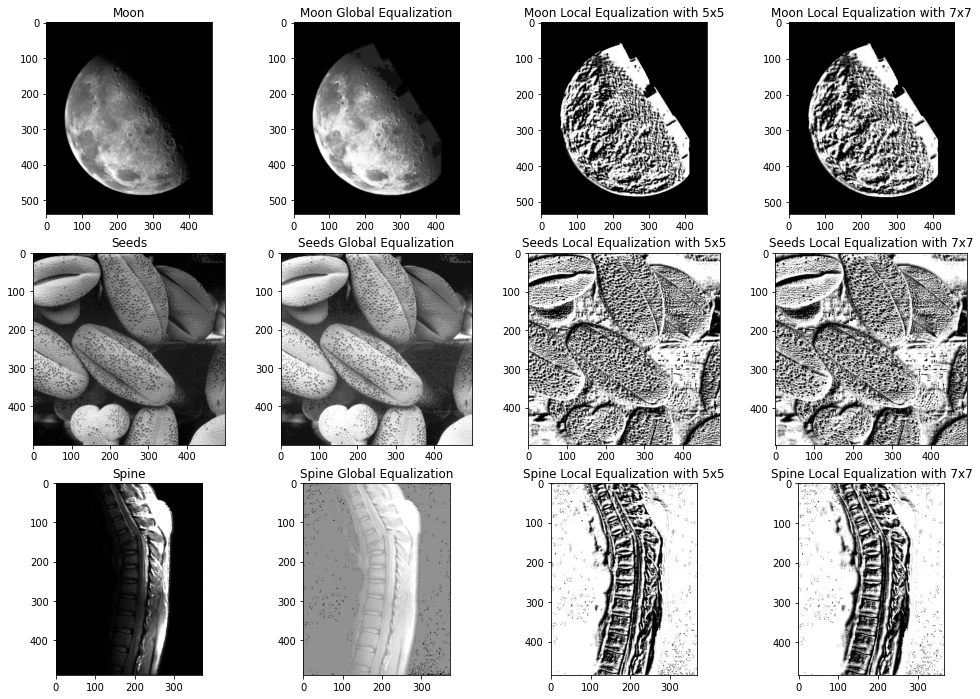

In [ ]:
n5 = 5
n7 = 7

outputMoon5 = localHistEqualizationSimple(lua, n5)
outputMoon7 = localHistEqualizationSimple(lua, n7)
plt.figure(figsize=(17, 12), constrained_layout=False)
plt.subplot(3,4,1),plt.imshow(lua,cmap=plt.cm.gray), plt.title("Moon")
plt.subplot(3,4,2),plt.imshow(moonNew,cmap=plt.cm.gray), plt.title("Moon Global Equalization")
plt.subplot(3,4,3),plt.imshow(outputMoon5,cmap=plt.cm.gray), plt.title("Moon Local Equalization with 5x5")
plt.subplot(3,4,4),plt.imshow(outputMoon7,cmap=plt.cm.gray), plt.title("Moon Local Equalization with 7x7")


outputSeeds5 = localHistEqualizationSimple(semente, n5)
outputSeeds7 = localHistEqualizationSimple(semente, n7)
plt.subplot(3,4,5),plt.imshow(semente,cmap=plt.cm.gray), plt.title("Seeds")
plt.subplot(3,4,6),plt.imshow(seedsNew,cmap=plt.cm.gray), plt.title("Seeds Global Equalization")
plt.subplot(3,4,7),plt.imshow(outputSeeds5,cmap=plt.cm.gray), plt.title("Seeds Local Equalization with 5x5")
plt.subplot(3,4,8),plt.imshow(outputSeeds7,cmap=plt.cm.gray), plt.title("Seeds Local Equalization with 7x7")

outputSpine5 = localHistEqualizationSimple(coluna, n5)
outputSpine7 = localHistEqualizationSimple(coluna, n7)
plt.subplot(3,4,9),plt.imshow(coluna,cmap=plt.cm.gray), plt.title("Spine")
plt.subplot(3,4,10),plt.imshow(spineNew,cmap=plt.cm.gray), plt.title("Spine Global Equalization")
plt.subplot(3,4,11),plt.imshow(outputSpine5,cmap=plt.cm.gray), plt.title("Spine Local Equalization with 5x5")
plt.subplot(3,4,12),plt.imshow(outputSpine7,cmap=plt.cm.gray), plt.title("Spine Local Equalization with 7x7")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7cebac5b10>,
 <BarContainer object of 256 artists>,
 Text(0.5, 1.0, 'Spine Local Equalization Histogram with 7x7'))

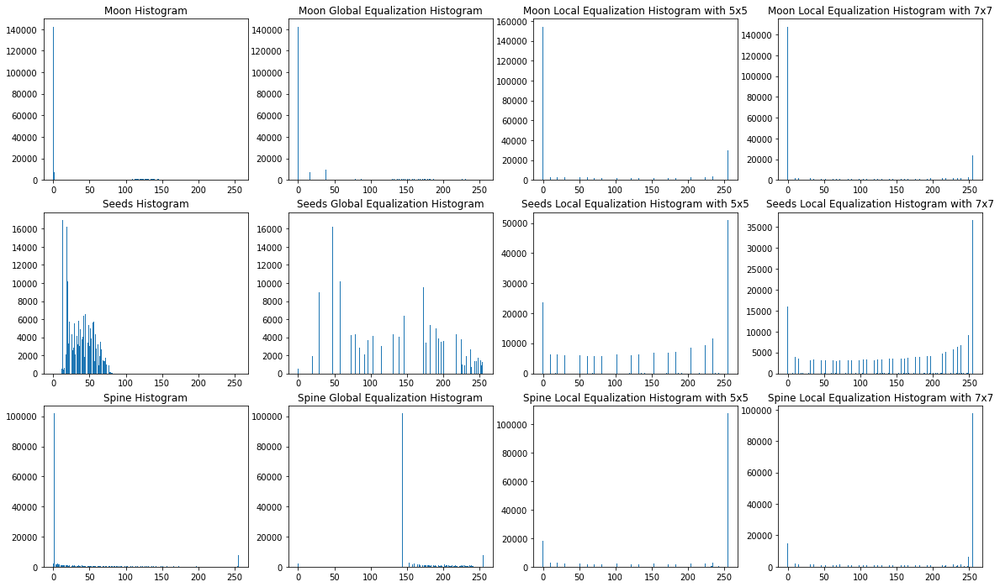

In [ ]:
# Histograms of Spine
histColuna, binsColuna = np.histogram(coluna.ravel(), 256, [0,256])
histColunaGlobal, binsColunaGlobal = np.histogram(spineNew.ravel(), 256, [0,256])
histColunaLocal5, binsColunaLocal5 = np.histogram(outputSpine5.ravel(), 256, [0,256])
histColunaLocal7, binsColunaLocal7 = np.histogram(outputSpine7.ravel(), 256, [0,256])

# Histograms of Seeds
histSemente, binsSemente = np.histogram(semente.ravel(), 256, [0,256])
histSementeGlobal, binsSementeGlobal = np.histogram(seedsNew.ravel(), 256, [0,256])
histSementeLocal5, binsSementeLocal5 = np.histogram(outputSeeds5.ravel(), 256, [0,256])
histSementeLocal7, binsSementeLocal7 = np.histogram(outputSeeds7.ravel(), 256, [0,256])

# Histograms of Moon
histLua, binsLua = np.histogram(lua.ravel(), 256, [0,256])
histLuaGlobal, binsLuaGlobal = np.histogram(moonNew.ravel(), 256, [0,256])
histLuaLocal5, binsLuaLocal5 = np.histogram(outputMoon5.ravel(), 256, [0,256])
histLuaLocal7, binsLuaLocal7 = np.histogram(outputMoon7.ravel(), 256, [0,256])

#plots
plt.figure(figsize=(20, 12), constrained_layout=False)
plt.subplot(3,4,1),plt.bar(range(len(histLua)), histLua),plt.title("Moon Histogram")
plt.subplot(3,4,2),plt.bar(range(len(histLuaGlobal)), histLuaGlobal), plt.title("Moon Global Equalization Histogram")
plt.subplot(3,4,3),plt.bar(range(len(histLuaLocal5)), histLuaLocal5), plt.title("Moon Local Equalization Histogram with 5x5")
plt.subplot(3,4,4),plt.bar(range(len(histLuaLocal7)), histLuaLocal7), plt.title("Moon Local Equalization Histogram with 7x7")

plt.subplot(3,4,5),plt.bar(range(len(histSemente)), histSemente),plt.title("Seeds Histogram")
plt.subplot(3,4,6),plt.bar(range(len(histSementeGlobal)), histSementeGlobal), plt.title("Seeds Global Equalization Histogram")
plt.subplot(3,4,7),plt.bar(range(len(histSementeLocal5)), histSementeLocal5), plt.title("Seeds Local Equalization Histogram with 5x5")
plt.subplot(3,4,8),plt.bar(range(len(histSementeLocal7)), histSementeLocal7), plt.title("Seeds Local Equalization Histogram with 7x7")

plt.subplot(3,4,9),plt.bar(range(len(histColuna)), histColuna),plt.title("Spine Histogram")
plt.subplot(3,4,10),plt.bar(range(len(histColunaGlobal)), histColunaGlobal), plt.title("Spine Global Equalization Histogram")
plt.subplot(3,4,11),plt.bar(range(len(histColunaLocal5)), histColunaLocal5), plt.title("Spine Local Equalization Histogram with 5x5")
plt.subplot(3,4,12),plt.bar(range(len(histColunaLocal7)), histColunaLocal7), plt.title("Spine Local Equalization Histogram with 7x7")


> Para essa Equalização Local, foi-se utilizado o exemplo 3.12, 3° edição, do livro base, onde diferente na função de equalização local anterior, há uma análise, a cdf da janela só é feita se $M_{local}<k_0 \times M_{global}$, $M$ é a média e $k_0$ é uma constante positiva, menor que 1. A outra condição é $\sigma_{global} \times k_1 < \sigma_{local}<\sigma_{global} \times k_2$, onde $\sigma$ é o desvio padrão, $k_2$ é uma constante positiva, que será maior que 1 se o interesse é realçar áreas claras e menor que 1, se for áreas escuras. Já $k_1<k_2$.

> A maior dificuldade desse método, é determinar qual é o valor correto dessas constantes para cada imagem.


(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ceacb63d0>,
 Text(0.5, 1.0, 'Spine Local Equalization with 7x7'))

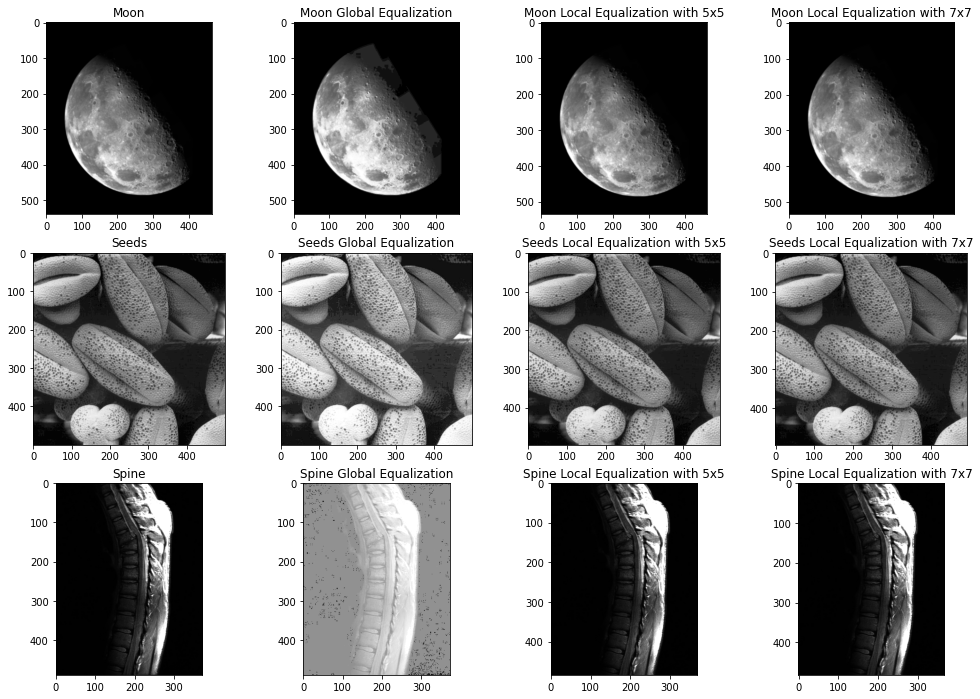

In [ ]:
#Coeficients for moon image
k0 = 0.8
k1 = 0.04
k2 = 0.1
n5 = 5
n7 = 7
outputMoon5 = localHistEqualization(lua, k0, k1, k2, n5)
outputMoon7 = localHistEqualization(lua, k0, k1, k2, n7)
plt.figure(figsize=(17, 12), constrained_layout=False)
plt.subplot(3,4,1),plt.imshow(lua,cmap=plt.cm.gray), plt.title("Moon")
plt.subplot(3,4,2),plt.imshow(moonNew,cmap=plt.cm.gray), plt.title("Moon Global Equalization")
plt.subplot(3,4,3),plt.imshow(outputMoon5,cmap=plt.cm.gray), plt.title("Moon Local Equalization with 5x5")
plt.subplot(3,4,4),plt.imshow(outputMoon7,cmap=plt.cm.gray), plt.title("Moon Local Equalization with 7x7")

#Coeficients for Seeds image
k0s = 0.4
k1s = 0.1
k2s = 0.2
outputSeeds5 = localHistEqualization(semente, k0s, k1s, k2s, n5)
outputSeeds7 = localHistEqualization(semente, k0s, k1s, k2s, n7)
plt.subplot(3,4,5),plt.imshow(semente,cmap=plt.cm.gray), plt.title("Seeds")
plt.subplot(3,4,6),plt.imshow(seedsNew,cmap=plt.cm.gray), plt.title("Seeds Global Equalization")
plt.subplot(3,4,7),plt.imshow(outputSeeds5,cmap=plt.cm.gray), plt.title("Seeds Local Equalization with 5x5")
plt.subplot(3,4,8),plt.imshow(outputSeeds7,cmap=plt.cm.gray), plt.title("Seeds Local Equalization with 7x7")

#Coeficients for Spine image
k0sp = 0.4
k1sp = 0.12
k2sp = 0.5
outputSpine5 = localHistEqualization(coluna, k0sp, k1sp, k2sp, n5)
outputSpine7 = localHistEqualization(coluna, k0sp, k1sp, k2sp, n7)
plt.subplot(3,4,9),plt.imshow(coluna,cmap=plt.cm.gray), plt.title("Spine")
plt.subplot(3,4,10),plt.imshow(spineNew,cmap=plt.cm.gray), plt.title("Spine Global Equalization")
plt.subplot(3,4,11),plt.imshow(outputSpine5,cmap=plt.cm.gray), plt.title("Spine Local Equalization with 5x5")
plt.subplot(3,4,12),plt.imshow(outputSpine7,cmap=plt.cm.gray), plt.title("Spine Local Equalization with 7x7")

> Se eu usar valores de $k_{1}$ e $k_2$ entre 0.02 e 0.03 na imagem da Lua, por exemplo, eu começo a degradar a imagem.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce8f00810>,
 <BarContainer object of 256 artists>,
 Text(0.5, 1.0, 'Spine Local Equalization Histogram with 7x7'))

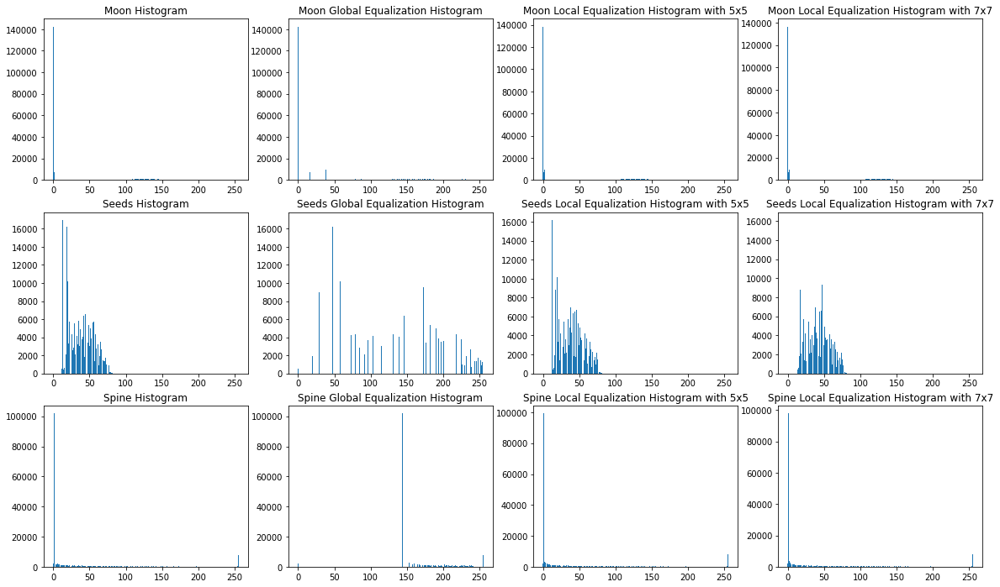

In [ ]:
# Histograms of Spine
histColuna, binsColuna = np.histogram(coluna.ravel(), 256, [0,256])
histColunaGlobal, binsColunaGlobal = np.histogram(spineNew.ravel(), 256, [0,256])
histColunaLocal5, binsColunaLocal5 = np.histogram(outputSpine5.ravel(), 256, [0,256])
histColunaLocal7, binsColunaLocal7 = np.histogram(outputSpine7.ravel(), 256, [0,256])

# Histograms of Seeds
histSemente, binsSemente = np.histogram(semente.ravel(), 256, [0,256])
histSementeGlobal, binsSementeGlobal = np.histogram(seedsNew.ravel(), 256, [0,256])
histSementeLocal5, binsSementeLocal5 = np.histogram(outputSeeds5.ravel(), 256, [0,256])
histSementeLocal7, binsSementeLocal7 = np.histogram(outputSeeds7.ravel(), 256, [0,256])

# Histograms of Moon
histLua, binsLua = np.histogram(lua.ravel(), 256, [0,256])
histLuaGlobal, binsLuaGlobal = np.histogram(moonNew.ravel(), 256, [0,256])
histLuaLocal5, binsLuaLocal5 = np.histogram(outputMoon5.ravel(), 256, [0,256])
histLuaLocal7, binsLuaLocal7 = np.histogram(outputMoon7.ravel(), 256, [0,256])

#plots
plt.figure(figsize=(20, 12), constrained_layout=False)
plt.subplot(3,4,1),plt.bar(range(len(histLua)), histLua),plt.title("Moon Histogram")
plt.subplot(3,4,2),plt.bar(range(len(histLuaGlobal)), histLuaGlobal), plt.title("Moon Global Equalization Histogram")
plt.subplot(3,4,3),plt.bar(range(len(histLuaLocal5)), histLuaLocal5), plt.title("Moon Local Equalization Histogram with 5x5")
plt.subplot(3,4,4),plt.bar(range(len(histLuaLocal7)), histLuaLocal7), plt.title("Moon Local Equalization Histogram with 7x7")

plt.subplot(3,4,5),plt.bar(range(len(histSemente)), histSemente),plt.title("Seeds Histogram")
plt.subplot(3,4,6),plt.bar(range(len(histSementeGlobal)), histSementeGlobal), plt.title("Seeds Global Equalization Histogram")
plt.subplot(3,4,7),plt.bar(range(len(histSementeLocal5)), histSementeLocal5), plt.title("Seeds Local Equalization Histogram with 5x5")
plt.subplot(3,4,8),plt.bar(range(len(histSementeLocal7)), histSementeLocal7), plt.title("Seeds Local Equalization Histogram with 7x7")

plt.subplot(3,4,9),plt.bar(range(len(histColuna)), histColuna),plt.title("Spine Histogram")
plt.subplot(3,4,10),plt.bar(range(len(histColunaGlobal)), histColunaGlobal), plt.title("Spine Global Equalization Histogram")
plt.subplot(3,4,11),plt.bar(range(len(histColunaLocal5)), histColunaLocal5), plt.title("Spine Local Equalization Histogram with 5x5")
plt.subplot(3,4,12),plt.bar(range(len(histColunaLocal7)), histColunaLocal7), plt.title("Spine Local Equalization Histogram with 7x7")


>>>
* A segunda equalização preserva melhor a imagem.
* Para a imagem da Coluna, se preservou menos, devido a natureza dos valores dos pixels (possui muitos zeros em uns na parte escura da imagem), ao normalizar a função acumulativa, eles recebem valores altos.


## 1.3 - *Histogram Matching*

> Para essa etapa, será usada as imagens da Bárbara, Lena e das Sementes.

> Semelhante aos casos anteriores, é necessário o cálculo da cdf tanto da imagem que será equalizada quanto da imagem Template, e com a função *histMatch*, após calcular as cdf's é realizado uma interpolação entre as cdf's de cada imagem, gerando a imagem equalizada a partir dos parâmetros da template.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ceaa83b50>,
 <BarContainer object of 256 artists>,
 Text(0.5, 1.0, 'Seeds Histogram'))

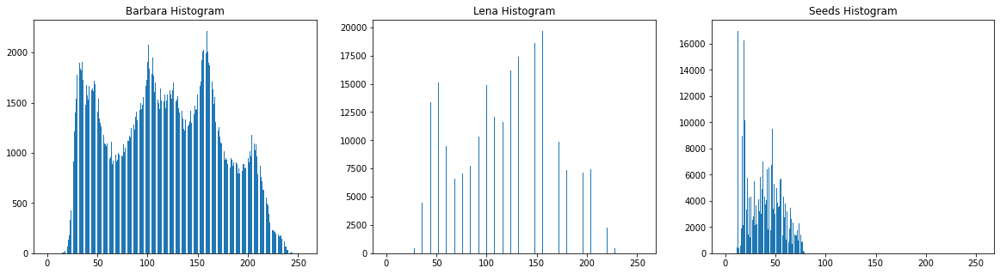

In [ ]:
#Histogram of the images
histBarbara, binsBarbara = np.histogram(barbara.ravel(), 256, [0,256])
histLena, binsLena = np.histogram(lena.ravel(), 256, [0,256])
histSeeds, binsSeeds = np.histogram(semente.ravel(), 256, [0,256])

#Plots
plt.figure(figsize=(20, 5), constrained_layout=False)
plt.subplot(1,3,1), plt.bar(range(len(histBarbara)), histBarbara), plt.title('Barbara Histogram')
plt.subplot(1,3,2), plt.bar(range(len(histLena)), histLena), plt.title('Lena Histogram')
plt.subplot(1,3,3), plt.bar(range(len(histSeeds)), histSeeds), plt.title('Seeds Histogram')

> Devido ao fato do histograma da imagem da Lena ser o melhor distribuído, eu o utilizei como imagem *template*.

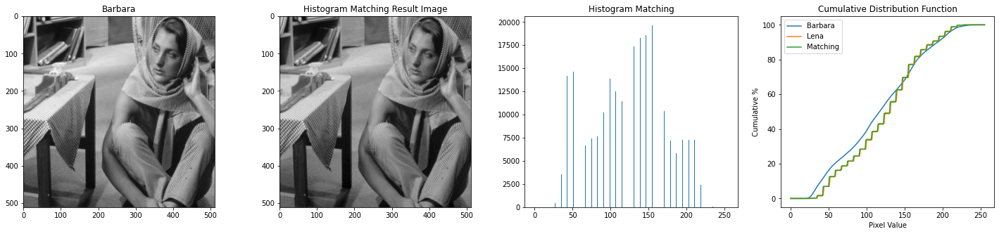

In [ ]:
#Make the histogram matching with Barbara and Lena images
outputMatch = histMatch(barbara, lena)
hist1, bins1 = np.histogram(outputMatch.ravel(), 256, [0,256])

#Calculate the cdf of the images
cdfBarbara = cdfSum(histBarbara)
cdfLena = cdfSum(histLena)
cdfBSeeds = cdfSum(histSeeds)
cdfMatch = cdfSum(hist1)

cdfBarbara = np.array(cdfBarbara)
cdfLena = np.array(cdfLena)
cdfSeeds = np.array(cdfSeeds)
cdfMatch = np.array(cdfMatch)

#Percentage analysis 
cdfBarbara = (cdfBarbara/255)*100
cdfLena = (cdfLena/255)*100
cdfSeeds = (cdfSeeds/255)*100
cdfMatch = (cdfMatch/255)*100

#plots
plt.figure(figsize=(25, 5), constrained_layout=False)
plt.subplot(1,4,1), plt.imshow(barbara,cmap=plt.cm.gray), plt.title('Barbara')
plt.subplot(1,4,2), plt.imshow(outputMatch,cmap=plt.cm.gray), plt.title('Histogram Matching Result Image')
plt.subplot(1,4,3), plt.bar(range(len(hist1)), hist1), plt.title('Histogram Matching')
plt.subplot(1,4,4)
plt.plot(cdfBarbara, label = 'Barbara')
plt.plot(cdfLena, label = 'Lena')
plt.plot(cdfMatch, label = 'Matching')
plt.legend(loc='upper left')
plt.title('Cumulative Distribution Function')
plt.xlabel('Pixel Value')
plt.ylabel('Cumulative %')
plt.show()

> Realizando o mesmo procedimento para as imagens Sementes e Lena.

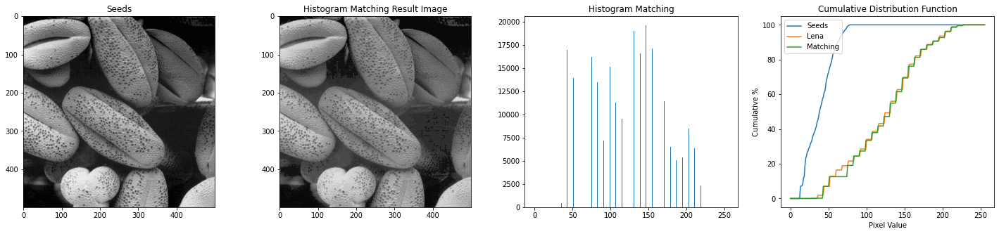

In [ ]:
#Making the histogram matching with Barbara and Lena images
outputMatchS = histMatch(semente, lena)
histS, binsS = np.histogram(outputMatchS.ravel(), 256, [0,256])

#Percentage analysis and the cdf of the image
cdfMatchS = cdfSum(histS)
cdfMatchS = np.array(cdfMatchS)
cdfMatchS = (cdfMatchS/255)*100

#plots
plt.figure(figsize=(25, 5), constrained_layout=False)
plt.subplot(1,4,1), plt.imshow(semente,cmap=plt.cm.gray), plt.title('Seeds')
plt.subplot(1,4,2), plt.imshow(outputMatchS,cmap=plt.cm.gray), plt.title('Histogram Matching Result Image')
plt.subplot(1,4,3), plt.bar(range(len(histS)), histS), plt.title('Histogram Matching')
plt.subplot(1,4,4)
plt.plot(cdfSeeds, label = 'Seeds')
plt.plot(cdfLena, label = 'Lena')
plt.plot(cdfMatchS, label = 'Matching')
plt.legend(loc='upper left')
plt.title('Cumulative Distribution Function')
plt.xlabel('Pixel Value')
plt.ylabel('Cumulative %')
plt.show()

# Parte 2

**Filtros Espaciais**

## 2.1 - Filtro de média espacial


>  Filtro de média, feito com a função *convolution2D*. A média do filtro é calculada antes de enviar à função, logo após a convolução é realizada. Na função o filtro é rotacionado em  $180^{\circ}$ .

>Ultilizei os filtros apresentados no livro, como na imagem a seguir.

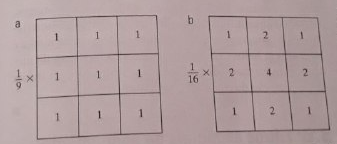

Digite o tamanho (exemplo, 3x3, digite 3) do filtro: 3

Digite o 1° coeficiente: 1

Digite o 2° coeficiente: 2

Digite o 3° coeficiente: 1

Digite o 4° coeficiente: 2

Digite o 5° coeficiente: 4

Digite o 6° coeficiente: 2

Digite o 7° coeficiente: 1

Digite o 8° coeficiente: 2

Digite o 9° coeficiente: 1


(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ceeaeb890>,
 Text(0.5, 1.0, 'Zelda Average Filtered Image'))

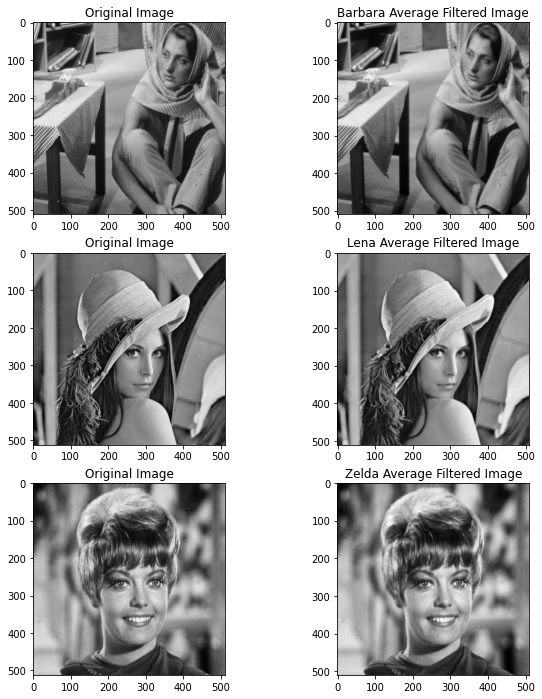

In [ ]:
#Catch parameter given by the user
try:
  n = int(input('Digite o tamanho (exemplo, 3x3, digite 3) do filtro: '))
except:
  print('\nValor inválido')
  n = int(input('\nDigite o tamanho (exemplo, 3x3, digite 3) do filtro: '))

coefficients = []
for i in range(0,n*n):
  try:
    coefficients.append(int(input('\nDigite o {}° coeficiente: '.format(i+1))))
  except:
    print('\nValor inválido')
    coefficients.append(int(input('\nDigite o {}° coeficiente novamente: '.format(i+1))))

#Calculate the average of the filter
coefficients = np.array(coefficients)
sumCoefficients = sum(coefficients)
filter = coefficients.reshape(n,n)
#Filter given by the user
kernel_ = (filter / sumCoefficients)

#Convolution of the image and the filter
result = convolution2d(barbara, kernel_)
resultL = convolution2d(lena, kernel_)
resultZ = convolution2d(zelda, kernel_)

#plots
plt.figure(figsize=(10, 12), constrained_layout=False)
plt.subplot(3,2,1),plt.imshow(barbara,cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,2,2),plt.imshow(result,cmap=plt.cm.gray), plt.title('Barbara Average Filtered Image')

plt.subplot(3,2,3),plt.imshow(lena,cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,2,4),plt.imshow(resultL,cmap=plt.cm.gray), plt.title('Lena Average Filtered Image')

plt.subplot(3,2,5),plt.imshow(zelda,cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,2,6),plt.imshow(resultZ,cmap=plt.cm.gray), plt.title('Zelda Average Filtered Image')

## 2.2 - Filtro Laplaciano Espacial

> A função *laplacian2D*, assim como de média, convolui o filtro com a imagem, o que muda são os resultados apresentados, ele apresenta 3. Uma imagem que enfatiza as bordas (como um negativo de intensidade do filtro), o resultado da filtragem e a imagem aguçada utilizando a máscara informada.

>Utilizei os filtros apresentados no livro, como mostra na imagem a seguir, onde para fazer o aguçamento da imagem é necessário informar a constante de aguçamento $c$. Para os filtros $a$ e $b$, a constante é $c = -1$ e para as demais $c = 1$. Como *default*, minha função já deixa $c = 1$.

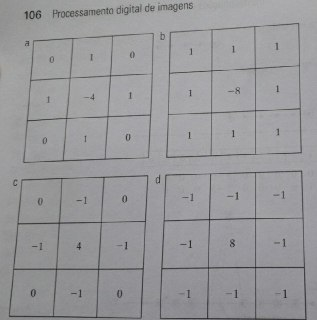

Digite o tamanho (exemplo, 3x3, digite 3) do filtro: 3

Digite o 1° coeficiente: 1

Digite o 2° coeficiente: 1

Digite o 3° coeficiente: 1

Digite o 4° coeficiente: 1

Digite o 5° coeficiente: -8

Digite o 6° coeficiente: 1

Digite o 7° coeficiente: 1

Digite o 8° coeficiente: 1

Digite o 9° coeficiente: 1

Você deseja informar a constante de aguçamento
do seu filtro [S/N]: S

Digite o valor da constante c: -1


(<matplotlib.axes._subplots.AxesSubplot at 0x7f1ae7f7df90>,
 Text(0.5, 1.0, 'Zelda Sharp Image'))

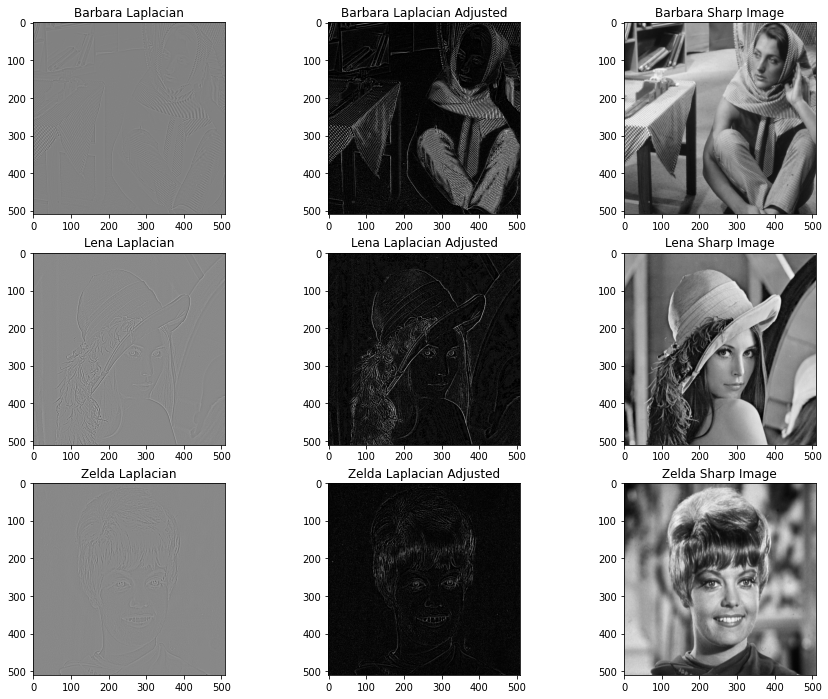

In [ ]:
#Catch the parameters of the user
try:
  n = int(input('Digite o tamanho (exemplo, 3x3, digite 3) do filtro: '))
except:
  print('\nValor inválido')
  n = int(input('\nDigite o tamanho (exemplo, 3x3, digite 3) do filtro: '))

coefficients = []
for i in range(0,n*n):
  try:
    coefficients.append(int(input('\nDigite o {}° coeficiente: '.format(i+1))))
  except:
    print('Valor inválido')
    coefficients.append(int(input('\nDigite o {}° coeficiente novamente: '.format(i+1))))

#If the user wants to define the sharpening constant of your filter.
resposta = input('\nVocê deseja informar a constante de aguçamento\ndo seu filtro [S/N]: ')
while (resposta != 'S') and (resposta != 'N'):
  resposta = input('\nResposta Inválida\nVocê deseja informar a constante de aguçamento\ndo seu filtro [S/N]: ')
if resposta == 'S':
  try:
    c = int(input('\nDigite o valor da constante c: '))
  except:
    print('\nValor inválido')
    c = int(input('Digite o valor da constante c: '))
#Define the user filter
coefficients = np.array(coefficients)
filter = coefficients.reshape(n,n)
kernel_ = filter

#Calculate the filter, the adjusted filter and the sharp image after filtering.
adjusted , laplacianFilter, sharpImage = laplacian2d(barbara, kernel_,c)
adjustedL , laplacianFilterL, sharpImageL = laplacian2d(lena, kernel_,c)
adjustedZ , laplacianFilterZ, sharpImageZ = laplacian2d(zelda, kernel_,c)

#plots
plt.figure(figsize=(15, 12), constrained_layout=False)
plt.subplot(3,3,1),plt.imshow(laplacianFilter,cmap=plt.cm.gray), plt.title('Barbara Laplacian')
plt.subplot(3,3,2),plt.imshow(adjusted,cmap=plt.cm.gray), plt.title('Barbara Laplacian Adjusted')
plt.subplot(3,3,3),plt.imshow(sharpImage,cmap=plt.cm.gray), plt.title('Barbara Sharp Image')

plt.subplot(3,3,4),plt.imshow(laplacianFilterL,cmap=plt.cm.gray), plt.title('Lena Laplacian')
plt.subplot(3,3,5),plt.imshow(adjustedL,cmap=plt.cm.gray), plt.title('Lena Laplacian Adjusted')
plt.subplot(3,3,6),plt.imshow(sharpImageL,cmap=plt.cm.gray), plt.title('Lena Sharp Image')

plt.subplot(3,3,7),plt.imshow(laplacianFilterZ,cmap=plt.cm.gray), plt.title('Zelda Laplacian')
plt.subplot(3,3,8),plt.imshow(adjustedZ,cmap=plt.cm.gray), plt.title('Zelda Laplacian Adjusted')
plt.subplot(3,3,9),plt.imshow(sharpImageZ,cmap=plt.cm.gray), plt.title('Zelda Sharp Image')

## 2.3 - Máscara de nitidez e filtragem *High-Boost* 



>Ultizando a ideia do item 2.1, foi-se desenvolvida a função *unsharpMasking*,
onde usando a função *convolution2D*, obtém-se uma imagem filtrada com um filtro de média (que a borra, $\bar{f}(x,y)$), logo após isso a função *unsharpMasking* determina a máscara de nitidez $g$, onde: $g_{máscara}(x,y) = f(x,y) - \bar{f}(x,y)$. Depois é adicionado uma porção ponderada da máscara de volta a imagem original, $f(x,y)$, gerando a filtragem de *High-Boost*, $g(x,y)$, onde: $g(x,y) = f(x,y) + k \times g_{máscara}(x,y)$, onde $k$ é uma constante positiva que define os pesos de generalizaçao. Para que seja  a filtragem de *High-Boost*, $k > 1$, senão $k$ atenua a máscara que nitidez. 

> Os resultados para esse próximo bloco, $k = 1.1$.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f8f55b3a6d0>,
 Text(0.5, 1.0, 'Zelda High-Boost Image'))

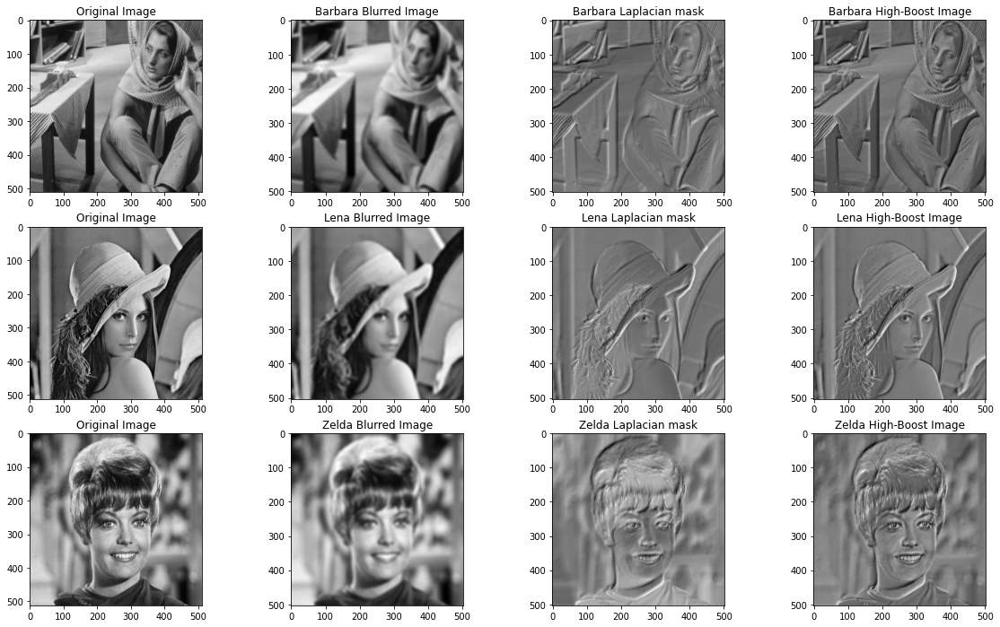

In [ ]:
# generic average filter
coefficients = np.ones((10,10))
sumCoefficients = sum(coefficients)
kernel = (coefficients / sumCoefficients)
# coefficient of high-boost filtering
k = 1.1
# High-Boost processing
filteredImage, mask, highBoost = unsharpMasking(barbara, kernel, k)
filteredImageL, maskL, highBoostL = unsharpMasking(lena, kernel, k)
filteredImageZ, maskZ, highBoostZ = unsharpMasking(zelda, kernel, k)

#plots
plt.figure(figsize=(20, 12), constrained_layout=False)
plt.subplot(3,4,1), plt.imshow(barbara, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,2), plt.imshow(filteredImage, cmap=plt.cm.gray), plt.title('Barbara Blurred Image')
plt.subplot(3,4,3), plt.imshow(mask, cmap=plt.cm.gray), plt.title('Barbara Laplacian mask')
plt.subplot(3,4,4), plt.imshow(highBoost, cmap=plt.cm.gray), plt.title('Barbara High-Boost Image')

plt.subplot(3,4,5), plt.imshow(lena, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,6), plt.imshow(filteredImageL, cmap=plt.cm.gray), plt.title('Lena Blurred Image')
plt.subplot(3,4,7), plt.imshow(maskL, cmap=plt.cm.gray), plt.title('Lena Laplacian mask')
plt.subplot(3,4,8), plt.imshow(highBoostL, cmap=plt.cm.gray), plt.title('Lena High-Boost Image')

plt.subplot(3,4,9), plt.imshow(zelda, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,10), plt.imshow(filteredImageZ, cmap=plt.cm.gray), plt.title('Zelda Blurred Image')
plt.subplot(3,4,11), plt.imshow(maskZ, cmap=plt.cm.gray), plt.title('Zelda Laplacian mask')
plt.subplot(3,4,12), plt.imshow(highBoostZ, cmap=plt.cm.gray), plt.title('Zelda High-Boost Image')

> Resultados com $k = 1$.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7cf4eafe50>,
 Text(0.5, 1.0, 'Zelda High-Boost Image'))

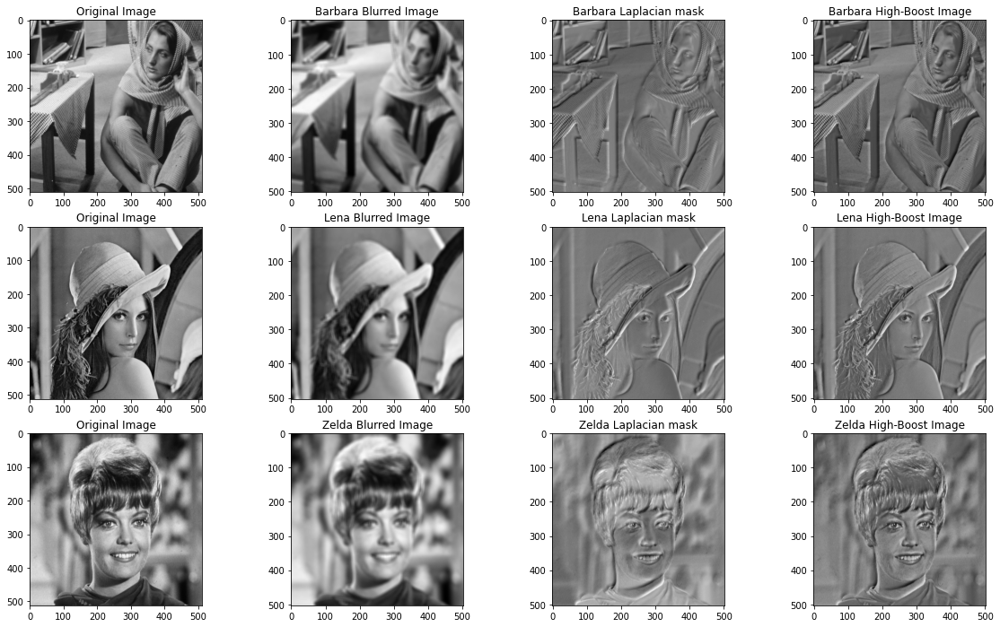

In [ ]:
# generic average filter
coefficients = np.ones((10,10))
sumCoefficients = sum(coefficients)
kernel = (coefficients / sumCoefficients)
# coefficient of high-boost filtering
k = 1
# High-Boost processing
filteredImage, mask, highBoost = unsharpMasking(barbara, kernel, k)
filteredImageL, maskL, highBoostL = unsharpMasking(lena, kernel, k)
filteredImageZ, maskZ, highBoostZ = unsharpMasking(zelda, kernel, k)

#plots
plt.figure(figsize=(20, 12), constrained_layout=False)
plt.subplot(3,4,1), plt.imshow(barbara, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,2), plt.imshow(filteredImage, cmap=plt.cm.gray), plt.title('Barbara Blurred Image')
plt.subplot(3,4,3), plt.imshow(mask, cmap=plt.cm.gray), plt.title('Barbara Laplacian mask')
plt.subplot(3,4,4), plt.imshow(highBoost, cmap=plt.cm.gray), plt.title('Barbara High-Boost Image')

plt.subplot(3,4,5), plt.imshow(lena, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,6), plt.imshow(filteredImageL, cmap=plt.cm.gray), plt.title('Lena Blurred Image')
plt.subplot(3,4,7), plt.imshow(maskL, cmap=plt.cm.gray), plt.title('Lena Laplacian mask')
plt.subplot(3,4,8), plt.imshow(highBoostL, cmap=plt.cm.gray), plt.title('Lena High-Boost Image')

plt.subplot(3,4,9), plt.imshow(zelda, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,10), plt.imshow(filteredImageZ, cmap=plt.cm.gray), plt.title('Zelda Blurred Image')
plt.subplot(3,4,11), plt.imshow(maskZ, cmap=plt.cm.gray), plt.title('Zelda Laplacian mask')
plt.subplot(3,4,12), plt.imshow(highBoostZ, cmap=plt.cm.gray), plt.title('Zelda High-Boost Image')

> Resultados com $k = 3$.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7cf49bd450>,
 Text(0.5, 1.0, 'Zelda High-Boost Image'))

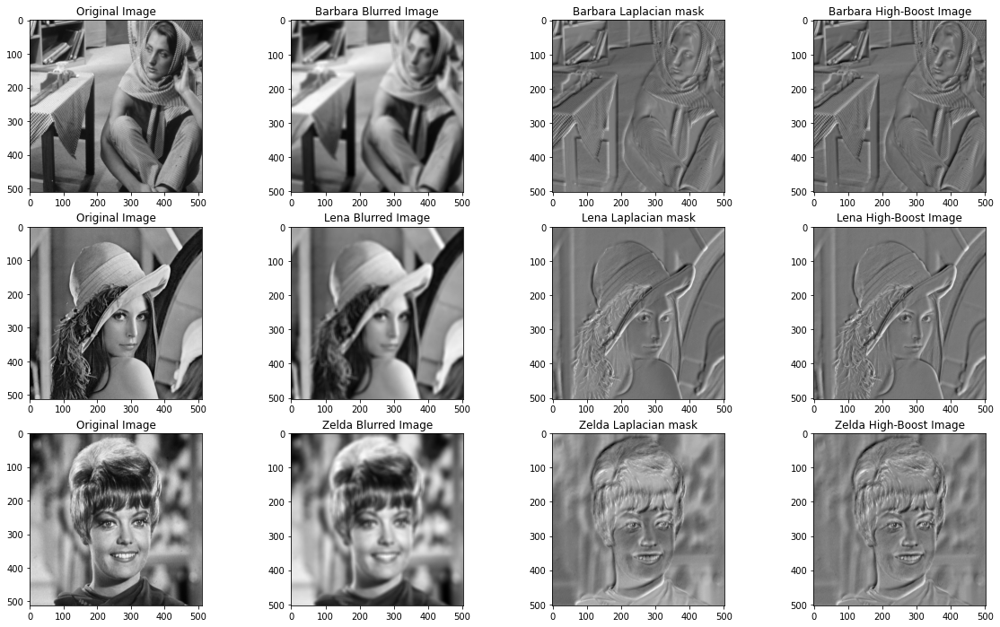

In [ ]:
# generic average filter
coefficients = np.ones((10,10))
sumCoefficients = sum(coefficients)
kernel = (coefficients / sumCoefficients)
# coefficient of high-boost filtering
k = 3
# High-Boost processing
filteredImage, mask, highBoost = unsharpMasking(barbara, kernel, k)
filteredImageL, maskL, highBoostL = unsharpMasking(lena, kernel, k)
filteredImageZ, maskZ, highBoostZ = unsharpMasking(zelda, kernel, k)

#plots
plt.figure(figsize=(20, 12), constrained_layout=False)
plt.subplot(3,4,1), plt.imshow(barbara, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,2), plt.imshow(filteredImage, cmap=plt.cm.gray), plt.title('Barbara Blurred Image')
plt.subplot(3,4,3), plt.imshow(mask, cmap=plt.cm.gray), plt.title('Barbara Laplacian mask')
plt.subplot(3,4,4), plt.imshow(highBoost, cmap=plt.cm.gray), plt.title('Barbara High-Boost Image')

plt.subplot(3,4,5), plt.imshow(lena, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,6), plt.imshow(filteredImageL, cmap=plt.cm.gray), plt.title('Lena Blurred Image')
plt.subplot(3,4,7), plt.imshow(maskL, cmap=plt.cm.gray), plt.title('Lena Laplacian mask')
plt.subplot(3,4,8), plt.imshow(highBoostL, cmap=plt.cm.gray), plt.title('Lena High-Boost Image')

plt.subplot(3,4,9), plt.imshow(zelda, cmap=plt.cm.gray), plt.title('Original Image')
plt.subplot(3,4,10), plt.imshow(filteredImageZ, cmap=plt.cm.gray), plt.title('Zelda Blurred Image')
plt.subplot(3,4,11), plt.imshow(maskZ, cmap=plt.cm.gray), plt.title('Zelda Laplacian mask')
plt.subplot(3,4,12), plt.imshow(highBoostZ, cmap=plt.cm.gray), plt.title('Zelda High-Boost Image')

>> **Comparando os resultados com os 3 valores de $k$, o melhor resultado aparente é com o $k = 1$.**

# Parte 3

**Filtros em domínio de Fourier**

## 3.1 - Filtros passa-baixas no domínio da frequência

### Filtro Ideal

> Um filtro passa-baixa ideal é definido no domínio de Fourier, definida na função *idealFilterLP*, como:
$\begin{equation}
H(u,v) =
    \begin{cases}
      1, & \mbox{se } D(u,v) \leq D_0\\
      0, & \mbox{se } D(u,v) > D_0
    \end{cases}
\end{equation}$

> Onde $D_0$ é uma distância à frequência de corte, e uma constante positiva, e $D(u,v)$ é a distância entre um ponto $(u,v)$ no domínio na frequência e o centro do retângulo de frequência, ou seja: $D(u,v) = \big( (u-p/2)^2+(v+q/2)^2 \big)^{1/2}$.

> Onde $p$ e $q$ são as dimensões da imagem. Essa função é definida em *distance*.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce2687fd0>,
 Text(0.5, 1.0, 'Processed Image'))

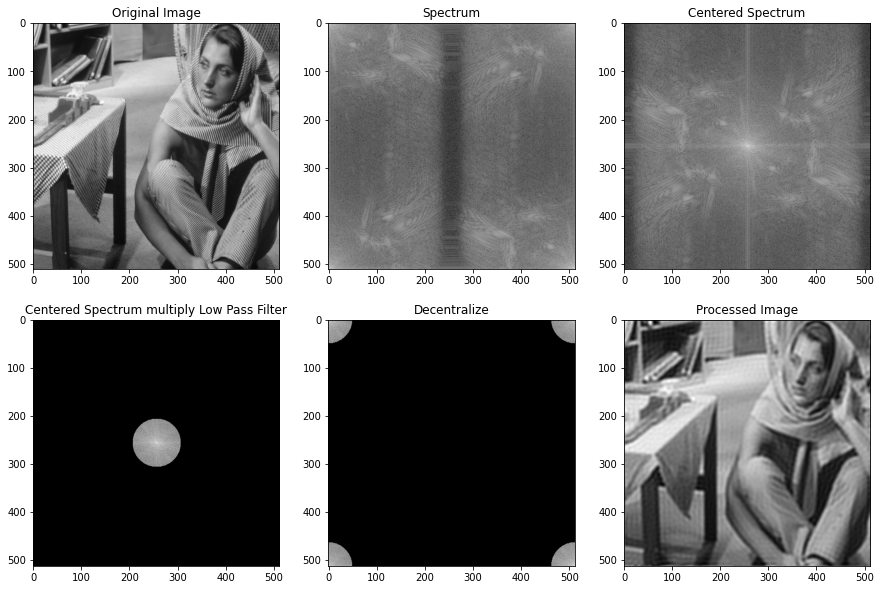

In [ ]:
#image in Fourier domain
fourierDomain = np.fft.fft2(barbara)
#Centering the image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
lowPassCenter = center * idealFilterLP(50, barbara.shape)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(barbara, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce24429d0>,
 Text(0.5, 1.0, 'Processed Image'))

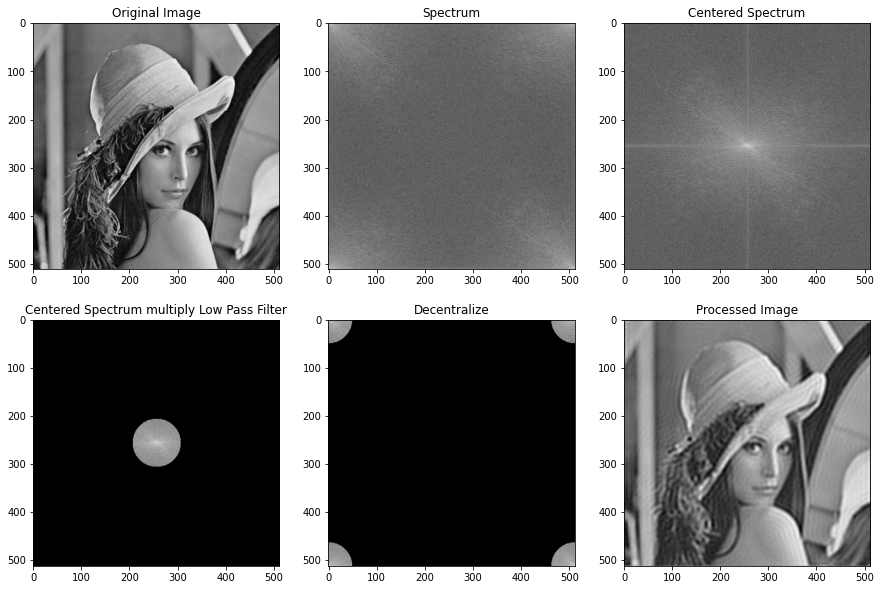

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(lena)
#Centering Image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
lowPassCenter = center * idealFilterLP(50, lena.shape)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(lena, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce2205410>,
 Text(0.5, 1.0, 'Processed Image'))

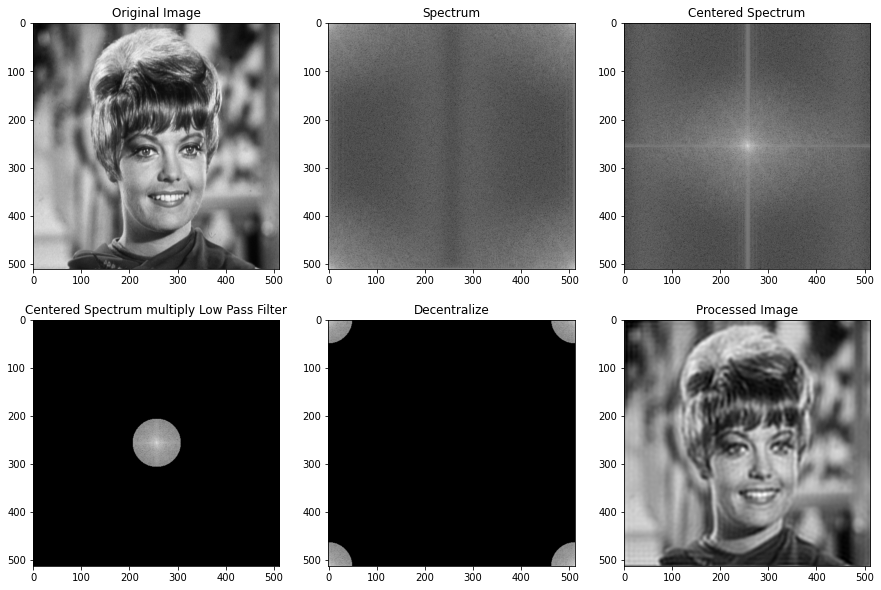

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(zelda)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering image
lowPassCenter = center * idealFilterLP(50, zelda.shape)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(zelda, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

### Filtro Gaussiano

>O filtro gaussiano passa-baixa, definido na função *gaussianLP*, é definido como:
$H(u,v) = e^{\frac{-D^2(u,v)}{2D_0^2}}$.


(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce1fc5d90>,
 Text(0.5, 1.0, 'Processed Image'))

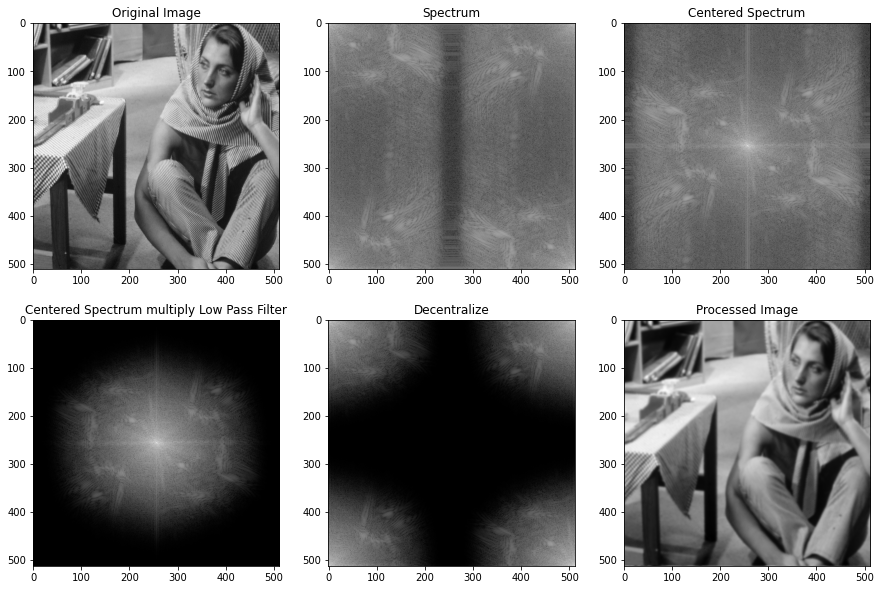

In [ ]:
#image in Fourier domain
fourierDomain = np.fft.fft2(barbara)
#Centering the image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
lowPassCenter = center * gaussianLP(50, barbara.shape)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(barbara, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce1dc7390>,
 Text(0.5, 1.0, 'Processed Image'))

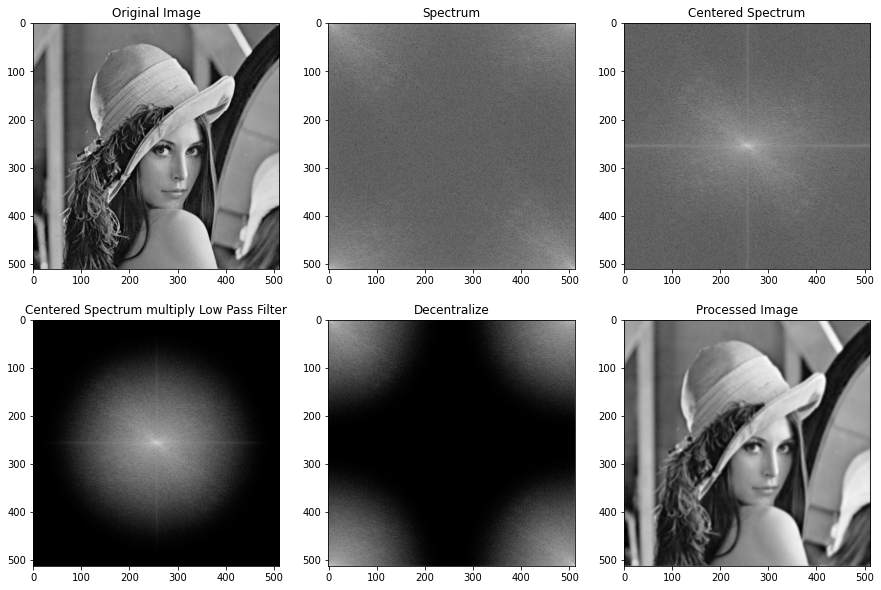

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(lena)
#Centering Image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
lowPassCenter = center * gaussianLP(50, lena.shape)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(lena, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce1963c50>,
 Text(0.5, 1.0, 'Processed Image'))

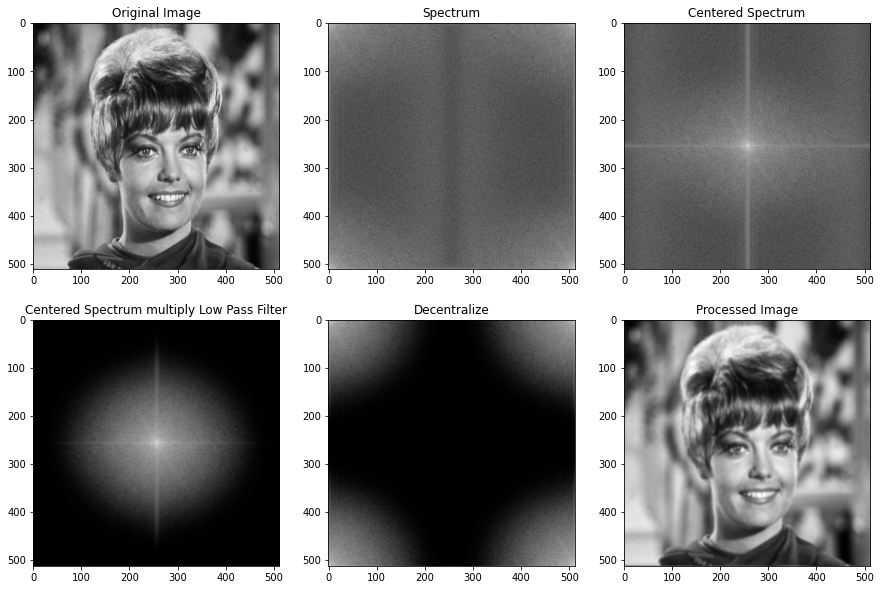

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(zelda)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering image
lowPassCenter = center * gaussianLP(50, zelda.shape)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(zelda, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

### Filtro *Butterworth*

> O filtro de *Butterworth* passa-baixa, de ordem $n$, e com uma frequência de corte a uma distância $D_0$ da origem, definido na função *butterworthLP*, é apresentado como:
$H(u,v) = \frac{1}{1+ \big(\frac{D(u,v)}{D_0}\big)^{2n}}$.


(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce618da10>,
 Text(0.5, 1.0, 'Processed Image'))

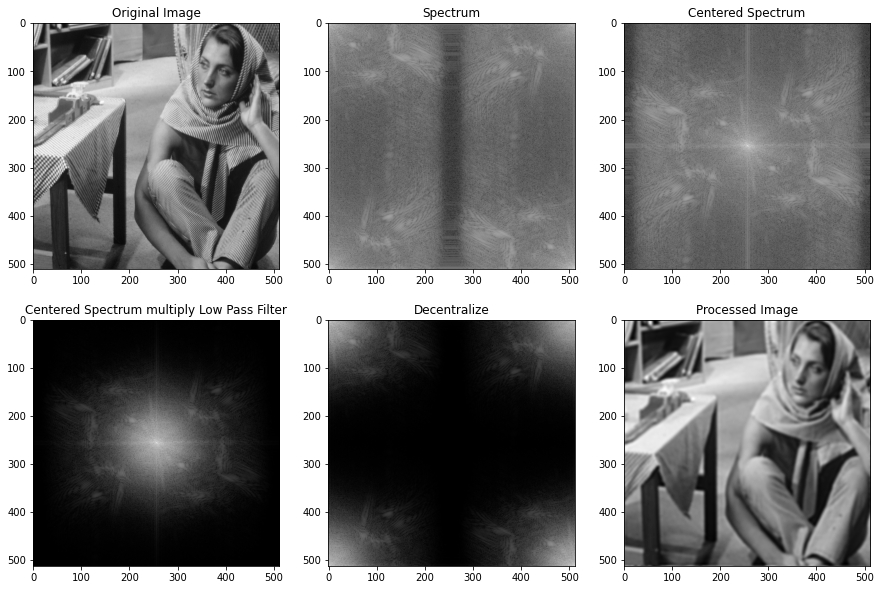

In [ ]:
#order
n = 3
#image in Fourier domain
fourierDomain = np.fft.fft2(barbara)
#Centering the image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
lowPassCenter = center * butterworthLP(50, barbara.shape,n)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(barbara, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce1b98310>,
 Text(0.5, 1.0, 'Processed Image'))

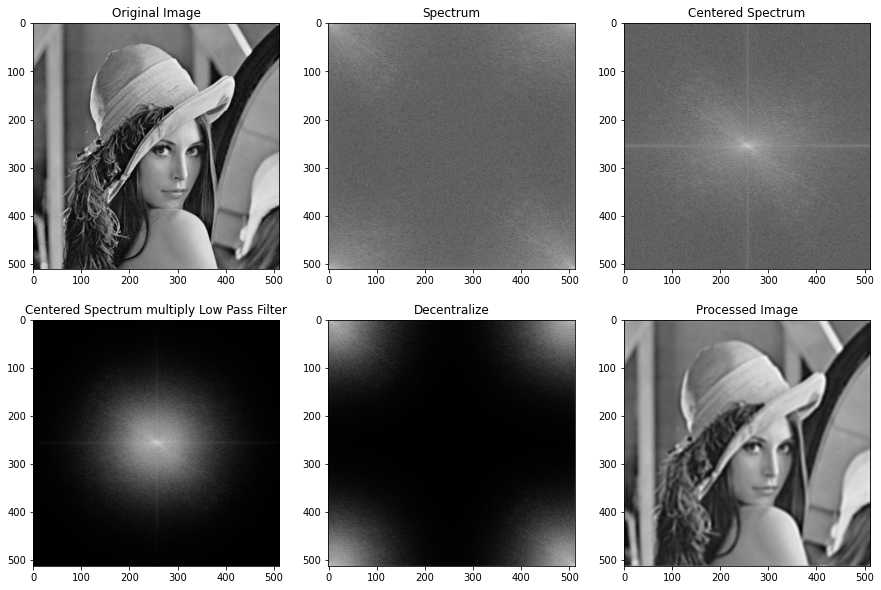

In [ ]:
#order
n = 3
#Image in Fourier Domain
fourierDomain = np.fft.fft2(lena)
#Centering Image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
lowPassCenter = center * butterworthLP(50, lena.shape,n)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(lena, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce16b26d0>,
 Text(0.5, 1.0, 'Processed Image'))

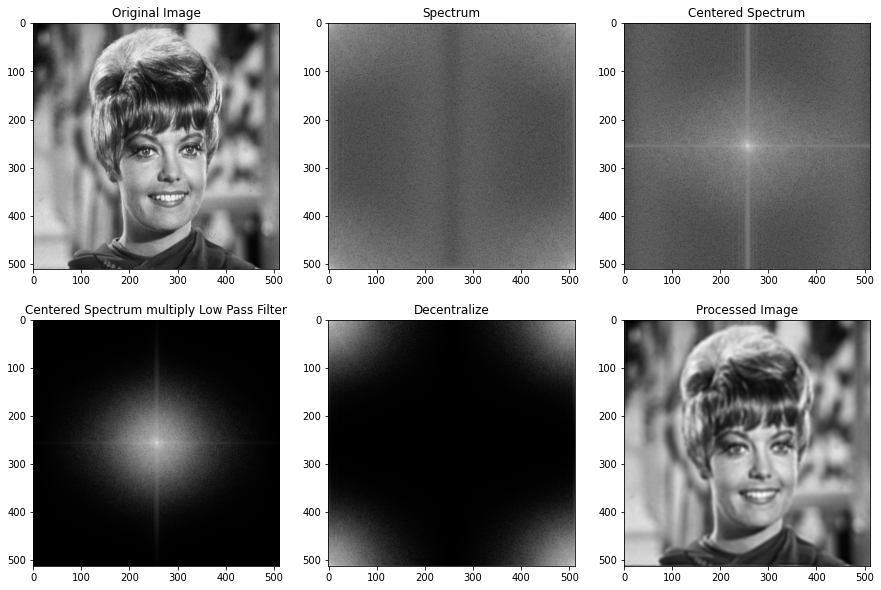

In [ ]:
n = 3
#Image in Fourier Domain
fourierDomain = np.fft.fft2(zelda)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering image
lowPassCenter = center * butterworthLP(50, zelda.shape,n)
lowPass = np.fft.ifftshift(lowPassCenter)
#Processed Image
inverseLowPass = np.fft.ifft2(lowPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(zelda, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(lowPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(lowPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseLowPass), cmap=plt.cm.gray), plt.title("Processed Image")

## 3.2 - Filtros passa-altas no domínio da frequência

### Filtro Ideal

> Um filtro passa-alta ideal é definido no domínio de Fourier, definida na função *idealFilterHP*, como:
$\begin{equation}
H(u,v) =
    \begin{cases}
      0, & \mbox{se } D(u,v) \leq D_0\\
      1, & \mbox{se } D(u,v) > D_0
    \end{cases}
\end{equation}$,
ou $H_{HP} = 1- H_{LP}$.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce0b349d0>,
 Text(0.5, 1.0, 'Processed Image'))

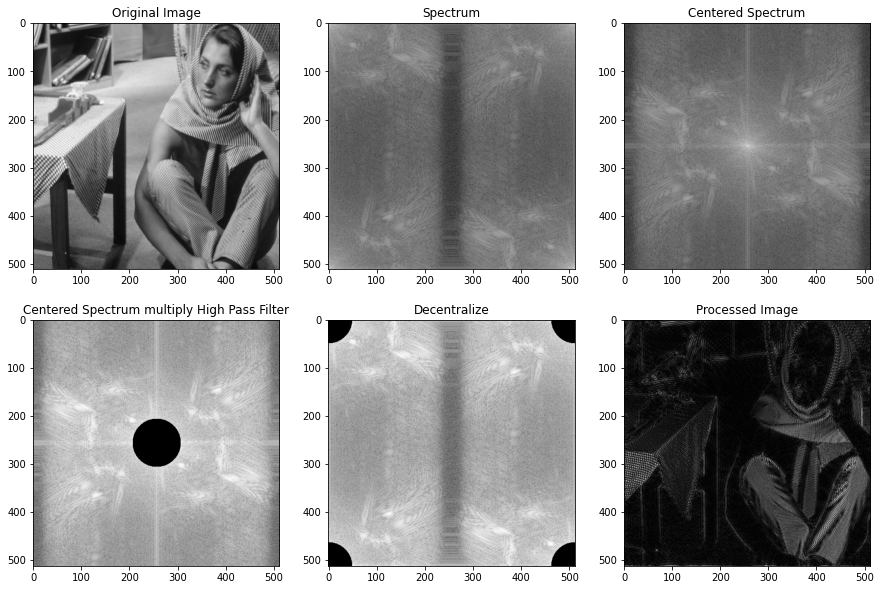

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(barbara)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * idealFilterHP(50, barbara.shape)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(barbara, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce1024dd0>,
 Text(0.5, 1.0, 'Processed Image'))

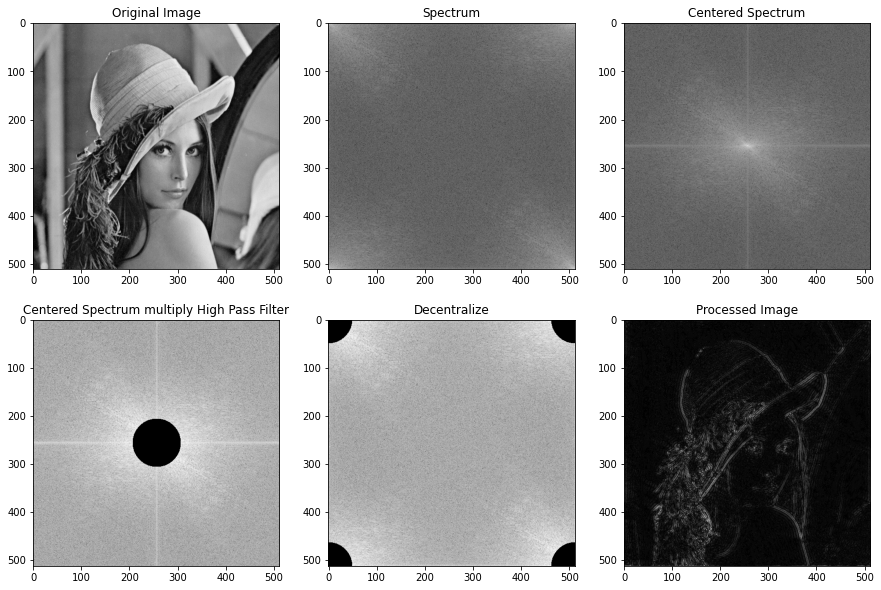

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(lena)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * idealFilterHP(50, lena.shape)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(lena, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce0dee150>,
 Text(0.5, 1.0, 'Processed Image'))

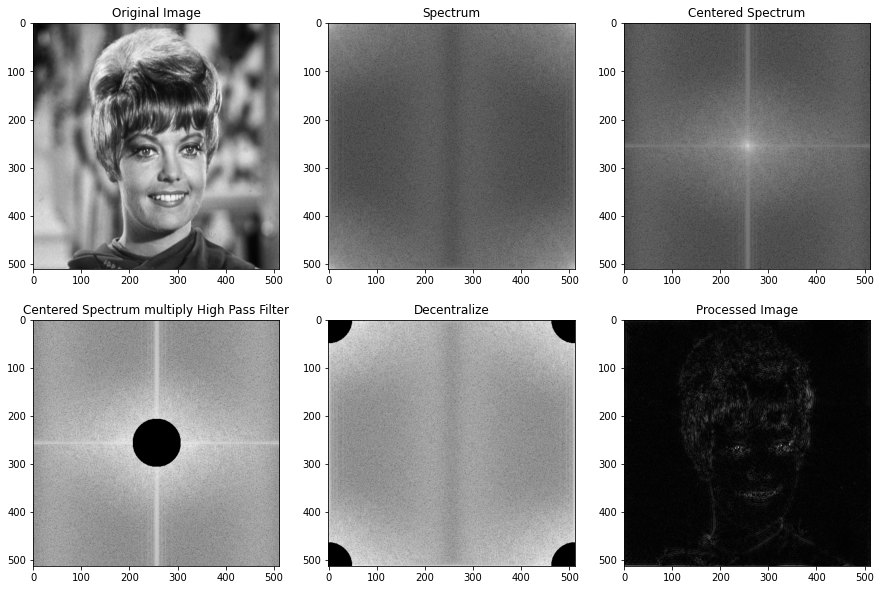

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(zelda)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * idealFilterHP(50, zelda.shape)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots

plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(zelda, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

### Filtro Gaussiano

>O filtro gaussiano passa-alta, definido na função *gaussianHP*, é definido como:
$H(u,v) = 1- e^{\frac{-D^2(u,v)}{2D_0^2}}$.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce06c3e50>,
 Text(0.5, 1.0, 'Processed Image'))

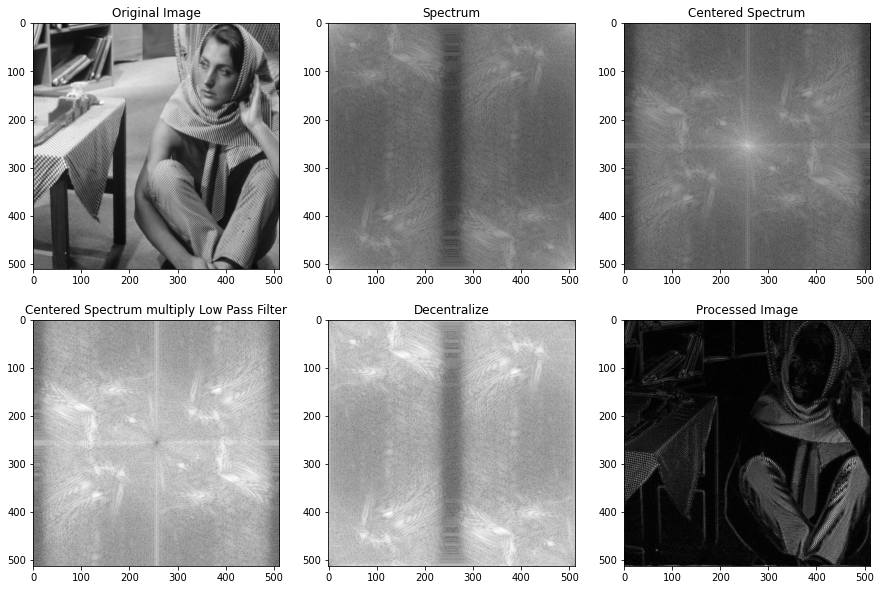

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(barbara)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * gaussianHP(50, barbara.shape)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(barbara, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply Low Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce048b6d0>,
 Text(0.5, 1.0, 'Processed Image'))

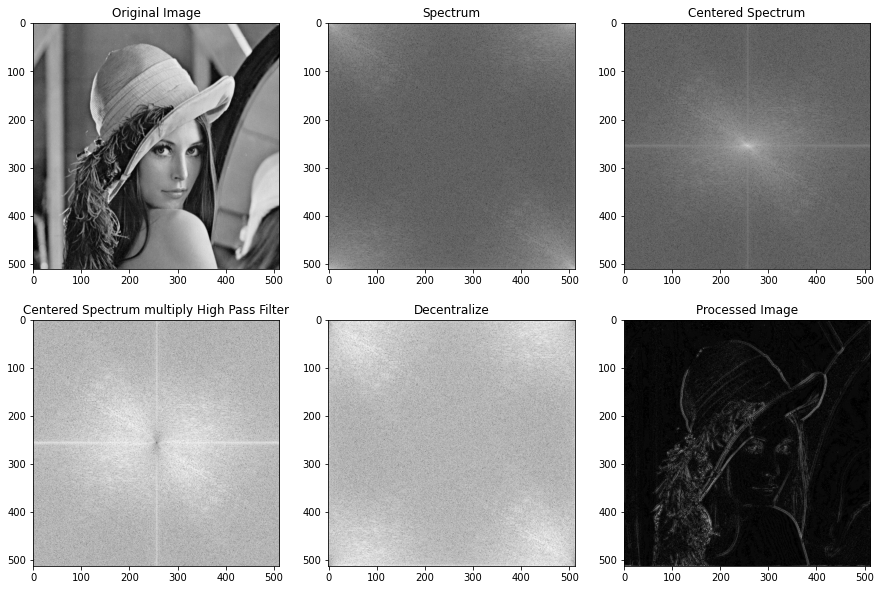

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(lena)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * gaussianHP(50, lena.shape)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(lena, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce0251f10>,
 Text(0.5, 1.0, 'Processed Image'))

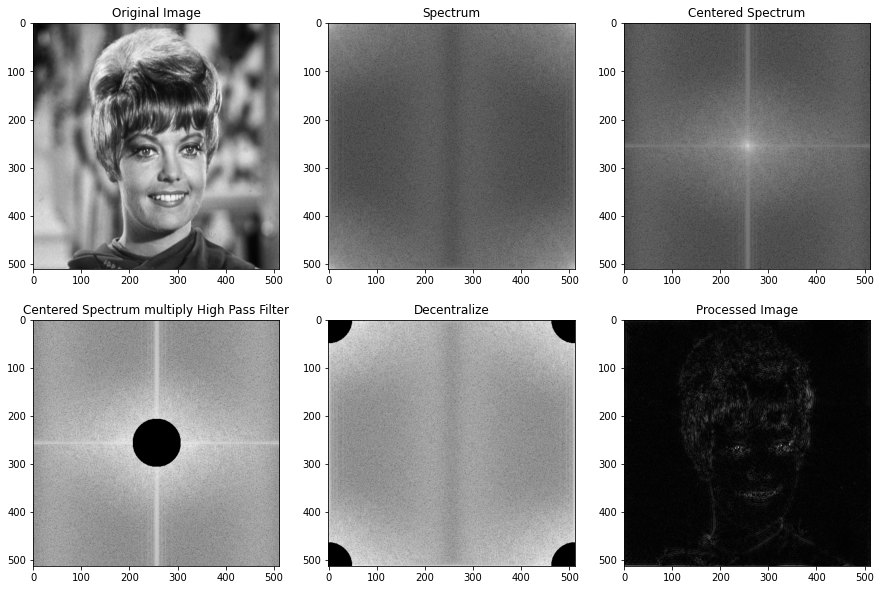

In [ ]:
#Image in Fourier Domain
fourierDomain = np.fft.fft2(zelda)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * idealFilterHP(50, zelda.shape)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(zelda, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

### Filtro *Butterworth*

> O filtro de *Butterworth* passa-alta, de ordem $n$, e com uma frequência de corte a uma distância $D_0$ da origem, definido na função *butterworthHP*, é apresentado como:
$H(u,v) = \frac{1}{1+ \big(\frac{D_0}{D(u,v)}\big)^{2n}}$.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce0019b90>,
 Text(0.5, 1.0, 'Processed Image'))

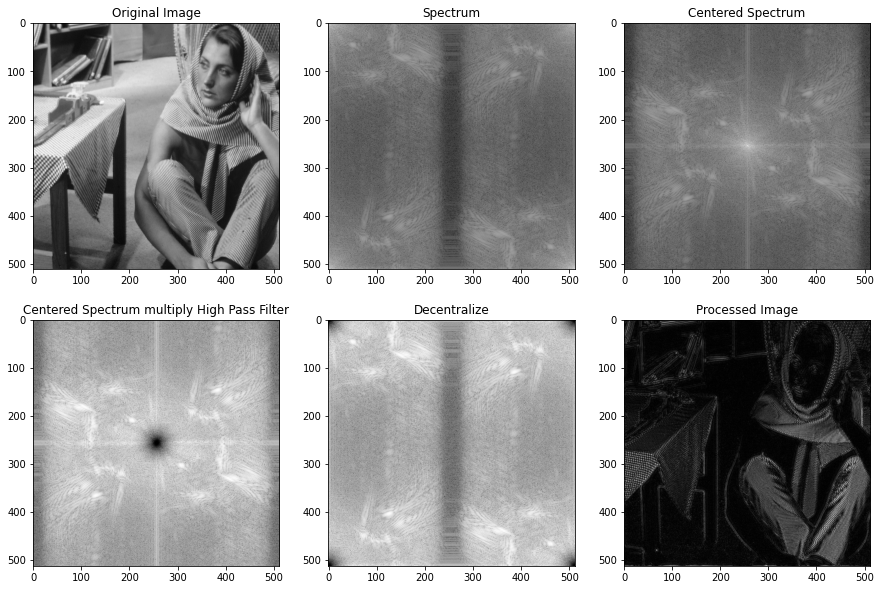

In [ ]:
#order
n = 3
#Image in Fourier Domain
fourierDomain = np.fft.fft2(barbara)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * butterworthHP(50, barbara.shape,n)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(barbara, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7cdfde2990>,
 Text(0.5, 1.0, 'Processed Image'))

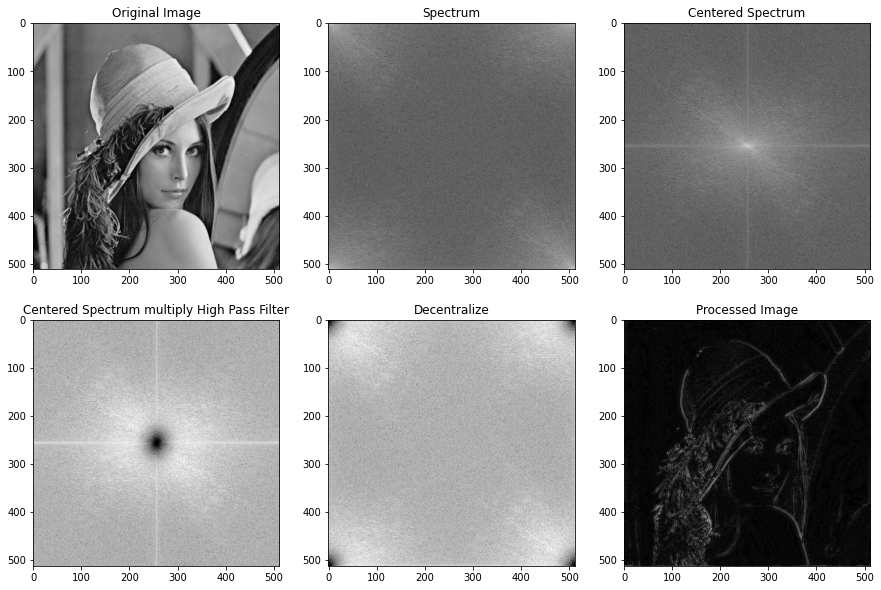

In [ ]:
#order
n = 3
#Image in Fourier Domain
fourierDomain = np.fft.fft2(lena)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * butterworthHP(50, lena.shape,n)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(lena, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7cdfba5ed0>,
 Text(0.5, 1.0, 'Processed Image'))

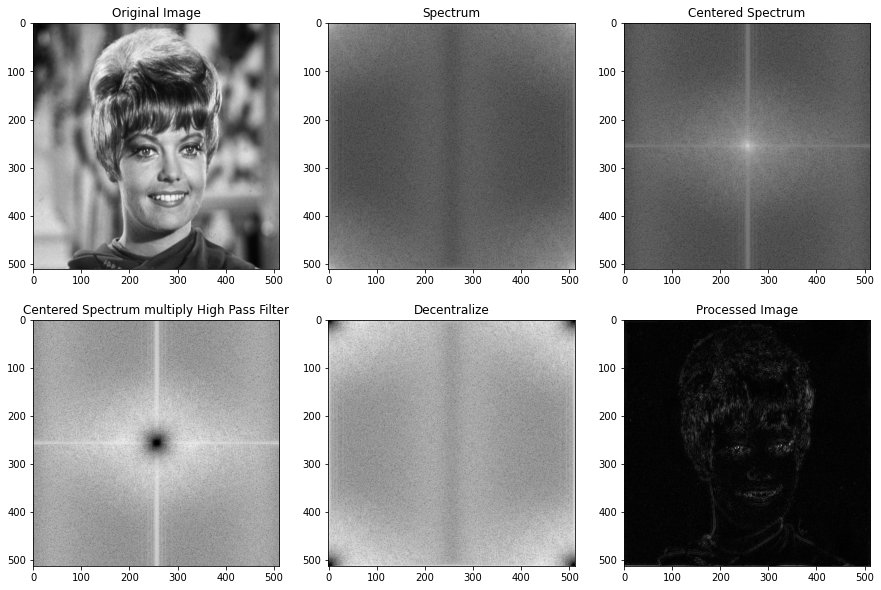

In [ ]:
#order
n = 3
#Image in Fourier Domain
fourierDomain = np.fft.fft2(zelda)
#Centering image
center = np.fft.fftshift(fourierDomain)
#Filtering Image
highPassCenter = center * butterworthHP(50, zelda.shape,n)
highPass = np.fft.ifftshift(highPassCenter)
#Processed Image
inverseHighPass = np.fft.ifft2(highPass)

#plots
plt.figure(figsize=(15, 10), constrained_layout=False)
plt.subplot(231), plt.imshow(zelda, cmap=plt.cm.gray), plt.title("Original Image")
plt.subplot(232), plt.imshow(np.log(1+np.abs(fourierDomain)), cmap=plt.cm.gray), plt.title("Spectrum")
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), cmap=plt.cm.gray), plt.title("Centered Spectrum")
plt.subplot(234), plt.imshow(np.log(1+np.abs(highPassCenter)), cmap=plt.cm.gray), plt.title("Centered Spectrum multiply High Pass Filter")
plt.subplot(235), plt.imshow(np.log(1+np.abs(highPass)), cmap=plt.cm.gray), plt.title("Decentralize")
plt.subplot(236), plt.imshow(np.abs(inverseHighPass), cmap=plt.cm.gray), plt.title("Processed Image")

## 3.3 - Máscara de nitidez e filtragem *High-Boost* no domínio da frequência

### Passa-baixas

> A ideia Máscara de nitidez e filtragem *High-Boost* é a mesma do item [2.3](https://colab.research.google.com/drive/1tc9Mzru2QOoyE6rJfRmt5VA3OJbC7iU5?authuser=2#scrollTo=m71sqOn7m_ET&line=2&uniqifier=1), no domínio de Fourier, com um filtro passa-baixa, definido na função *unsharpMaskingFourierLP*, pode ser representado como:
$g(x,y) = \mathcal{F}^{-1}\{[1+k \times [1-H_{LP}]]F(u,v)\}$.

>Onde $H_{LP}$ é obtida com os filtros passa-baixas mostrados no item [3.1](https://colab.research.google.com/drive/1tc9Mzru2QOoyE6rJfRmt5VA3OJbC7iU5?authuser=2#scrollTo=_WycZhfdoEHR), $\mathcal{F}^{-1}$ é a transformada inversa de Fourier e $F(u,v)$ é a imagem original no domínio de Fourier.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce4c94e50>,
 Text(0.5, 1.0, 'High-Boost with k = 3.5'))

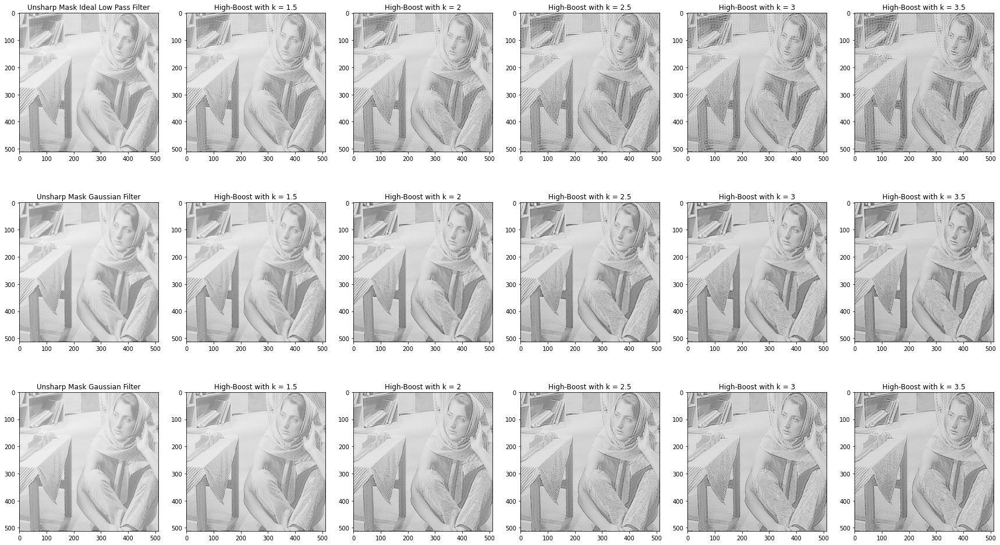

In [ ]:
#blurred image
fourierDomain = np.fft.fft2(barbara)
center = np.fft.fftshift(fourierDomain)
lowPassCenter = center * idealFilterLP(50, barbara.shape)
lowPassCenterG = center * gaussianLP(50, barbara.shape)
lowPassCenterB = center * butterworthLP(50, barbara.shape, 3)

#unsharp masking and high-boost
resultIdeal1 = unsharpMaskingFourierLP(center, lowPassCenter, 1)
resultIdeal2 = unsharpMaskingFourierLP(center, lowPassCenter, 1.5)
resultIdeal3 = unsharpMaskingFourierLP(center, lowPassCenter, 2)
resultIdeal4 = unsharpMaskingFourierLP(center, lowPassCenter, 2.5)
resultIdeal5 = unsharpMaskingFourierLP(center, lowPassCenter, 3)
resultIdeal6 = unsharpMaskingFourierLP(center, lowPassCenter, 3.5)

resultG1 = unsharpMaskingFourierLP(center, lowPassCenterG, 1)
resultG2 = unsharpMaskingFourierLP(center, lowPassCenterG, 1.5)
resultG3 = unsharpMaskingFourierLP(center, lowPassCenterG, 2)
resultG4 = unsharpMaskingFourierLP(center, lowPassCenterG, 2.5)
resultG5 = unsharpMaskingFourierLP(center, lowPassCenterG, 3)
resultG6 = unsharpMaskingFourierLP(center, lowPassCenterG, 3.5)

resultB1 = unsharpMaskingFourierLP(center, lowPassCenterB, 1)
resultB2 = unsharpMaskingFourierLP(center, lowPassCenterB, 1.5)
resultB3 = unsharpMaskingFourierLP(center, lowPassCenterB, 2)
resultB4 = unsharpMaskingFourierLP(center, lowPassCenterB, 2.5)
resultB5 = unsharpMaskingFourierLP(center, lowPassCenterB, 3)
resultB6 = unsharpMaskingFourierLP(center, lowPassCenterB, 3.5)

#plots
plt.figure(figsize=(30, 17), constrained_layout=False)
plt.subplot(3,6,1), plt.imshow(np.log(1+np.abs(resultIdeal1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Ideal Low Pass Filter")
plt.subplot(3,6,2), plt.imshow(np.log(1+np.abs(resultIdeal2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,3), plt.imshow(np.log(1+np.abs(resultIdeal3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,4), plt.imshow(np.log(1+np.abs(resultIdeal4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,5), plt.imshow(np.log(1+np.abs(resultIdeal5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,6), plt.imshow(np.log(1+np.abs(resultIdeal6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,7), plt.imshow(np.log(1+np.abs(resultG1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,8), plt.imshow(np.log(1+np.abs(resultG2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,9), plt.imshow(np.log(1+np.abs(resultG3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,10), plt.imshow(np.log(1+np.abs(resultG4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,11), plt.imshow(np.log(1+np.abs(resultG5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,12), plt.imshow(np.log(1+np.abs(resultG6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,13), plt.imshow(np.log(1+np.abs(resultB1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,14), plt.imshow(np.log(1+np.abs(resultB2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,15), plt.imshow(np.log(1+np.abs(resultB3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,16), plt.imshow(np.log(1+np.abs(resultB4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,17), plt.imshow(np.log(1+np.abs(resultB5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,18), plt.imshow(np.log(1+np.abs(resultB6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce45beed0>,
 Text(0.5, 1.0, 'High-Boost with k = 3.5'))

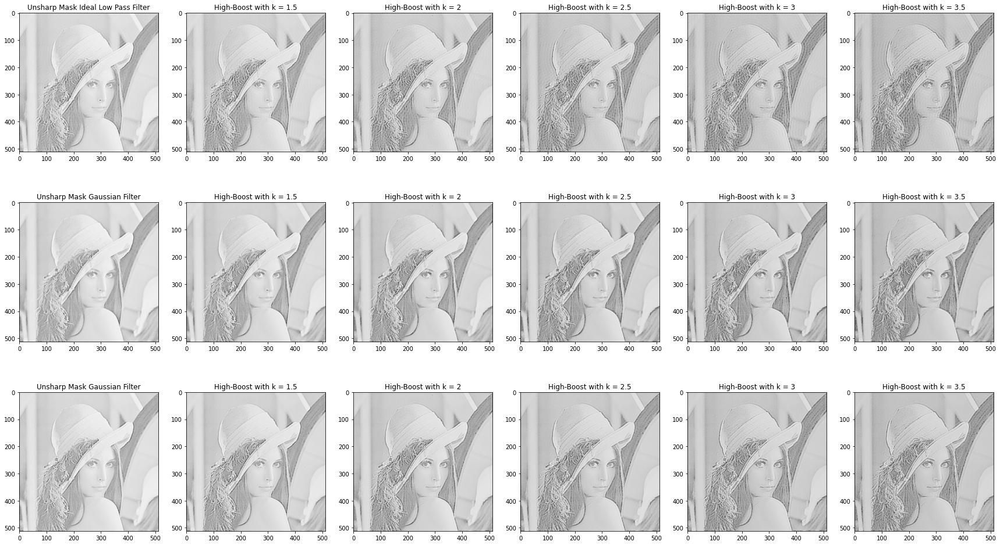

In [ ]:
#blurred image
fourierDomain = np.fft.fft2(lena)
center = np.fft.fftshift(fourierDomain)
lowPassCenter = center * idealFilterLP(50, lena.shape)
lowPassCenterG = center * gaussianLP(50, lena.shape)
lowPassCenterB = center * butterworthLP(50, lena.shape, 3)

#unsharp masking and high-boost
resultIdeal1 = unsharpMaskingFourierLP(center, lowPassCenter, 1)
resultIdeal2 = unsharpMaskingFourierLP(center, lowPassCenter, 1.5)
resultIdeal3 = unsharpMaskingFourierLP(center, lowPassCenter, 2)
resultIdeal4 = unsharpMaskingFourierLP(center, lowPassCenter, 2.5)
resultIdeal5 = unsharpMaskingFourierLP(center, lowPassCenter, 3)
resultIdeal6 = unsharpMaskingFourierLP(center, lowPassCenter, 3.5)

resultG1 = unsharpMaskingFourierLP(center, lowPassCenterG, 1)
resultG2 = unsharpMaskingFourierLP(center, lowPassCenterG, 1.5)
resultG3 = unsharpMaskingFourierLP(center, lowPassCenterG, 2)
resultG4 = unsharpMaskingFourierLP(center, lowPassCenterG, 2.5)
resultG5 = unsharpMaskingFourierLP(center, lowPassCenterG, 3)
resultG6 = unsharpMaskingFourierLP(center, lowPassCenterG, 3.5)

resultB1 = unsharpMaskingFourierLP(center, lowPassCenterB, 1)
resultB2 = unsharpMaskingFourierLP(center, lowPassCenterB, 1.5)
resultB3 = unsharpMaskingFourierLP(center, lowPassCenterB, 2)
resultB4 = unsharpMaskingFourierLP(center, lowPassCenterB, 2.5)
resultB5 = unsharpMaskingFourierLP(center, lowPassCenterB, 3)
resultB6 = unsharpMaskingFourierLP(center, lowPassCenterB, 3.5)

#plots
plt.figure(figsize=(30, 17), constrained_layout=False)
plt.subplot(3,6,1), plt.imshow(np.log(1+np.abs(resultIdeal1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Ideal Low Pass Filter")
plt.subplot(3,6,2), plt.imshow(np.log(1+np.abs(resultIdeal2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,3), plt.imshow(np.log(1+np.abs(resultIdeal3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,4), plt.imshow(np.log(1+np.abs(resultIdeal4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,5), plt.imshow(np.log(1+np.abs(resultIdeal5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,6), plt.imshow(np.log(1+np.abs(resultIdeal6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,7), plt.imshow(np.log(1+np.abs(resultG1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,8), plt.imshow(np.log(1+np.abs(resultG2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,9), plt.imshow(np.log(1+np.abs(resultG3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,10), plt.imshow(np.log(1+np.abs(resultG4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,11), plt.imshow(np.log(1+np.abs(resultG5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,12), plt.imshow(np.log(1+np.abs(resultG6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,13), plt.imshow(np.log(1+np.abs(resultB1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,14), plt.imshow(np.log(1+np.abs(resultB2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,15), plt.imshow(np.log(1+np.abs(resultB3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,16), plt.imshow(np.log(1+np.abs(resultB4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,17), plt.imshow(np.log(1+np.abs(resultB5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,18), plt.imshow(np.log(1+np.abs(resultB6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce3f07f50>,
 Text(0.5, 1.0, 'High-Boost with k = 3.5'))

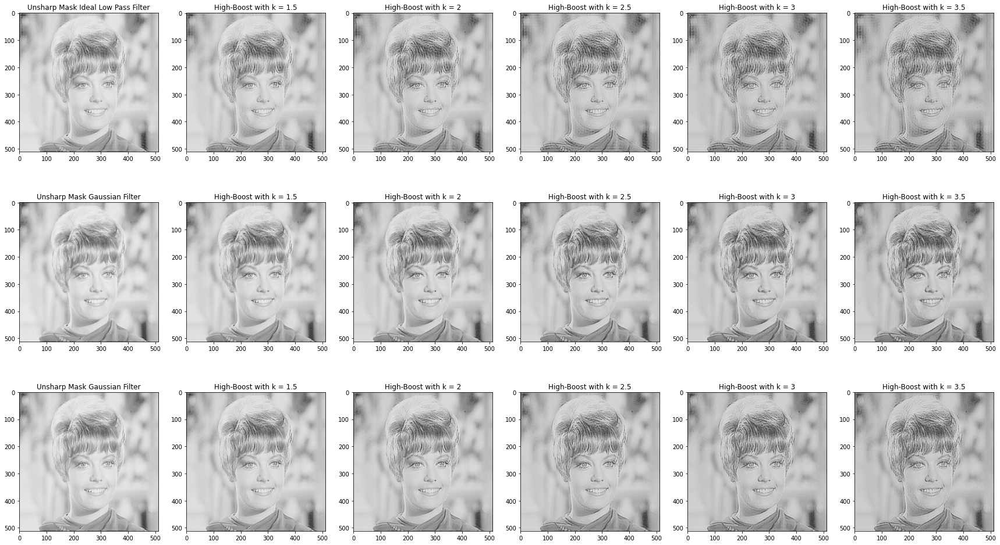

In [ ]:
#blurred image
fourierDomain = np.fft.fft2(zelda)
center = np.fft.fftshift(fourierDomain)
lowPassCenter = center * idealFilterLP(50, zelda.shape)
lowPassCenterG = center * gaussianLP(50, zelda.shape)
lowPassCenterB = center * butterworthLP(50, zelda.shape, 3)

#unsharp masking and High-Boost
resultIdeal1 = unsharpMaskingFourierLP(center, lowPassCenter, 1)
resultIdeal2 = unsharpMaskingFourierLP(center, lowPassCenter, 1.5)
resultIdeal3 = unsharpMaskingFourierLP(center, lowPassCenter, 2)
resultIdeal4 = unsharpMaskingFourierLP(center, lowPassCenter, 2.5)
resultIdeal5 = unsharpMaskingFourierLP(center, lowPassCenter, 3)
resultIdeal6 = unsharpMaskingFourierLP(center, lowPassCenter, 3.5)

resultG1 = unsharpMaskingFourierLP(center, lowPassCenterG, 1)
resultG2 = unsharpMaskingFourierLP(center, lowPassCenterG, 1.5)
resultG3 = unsharpMaskingFourierLP(center, lowPassCenterG, 2)
resultG4 = unsharpMaskingFourierLP(center, lowPassCenterG, 2.5)
resultG5 = unsharpMaskingFourierLP(center, lowPassCenterG, 3)
resultG6 = unsharpMaskingFourierLP(center, lowPassCenterG, 3.5)

resultB1 = unsharpMaskingFourierLP(center, lowPassCenterB, 1)
resultB2 = unsharpMaskingFourierLP(center, lowPassCenterB, 1.5)
resultB3 = unsharpMaskingFourierLP(center, lowPassCenterB, 2)
resultB4 = unsharpMaskingFourierLP(center, lowPassCenterB, 2.5)
resultB5 = unsharpMaskingFourierLP(center, lowPassCenterB, 3)
resultB6 = unsharpMaskingFourierLP(center, lowPassCenterB, 3.5)

#plots
plt.figure(figsize=(30, 17), constrained_layout=False)
plt.subplot(3,6,1), plt.imshow(np.log(1+np.abs(resultIdeal1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Ideal Low Pass Filter")
plt.subplot(3,6,2), plt.imshow(np.log(1+np.abs(resultIdeal2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,3), plt.imshow(np.log(1+np.abs(resultIdeal3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,4), plt.imshow(np.log(1+np.abs(resultIdeal4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,5), plt.imshow(np.log(1+np.abs(resultIdeal5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,6), plt.imshow(np.log(1+np.abs(resultIdeal6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,7), plt.imshow(np.log(1+np.abs(resultG1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,8), plt.imshow(np.log(1+np.abs(resultG2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,9), plt.imshow(np.log(1+np.abs(resultG3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,10), plt.imshow(np.log(1+np.abs(resultG4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,11), plt.imshow(np.log(1+np.abs(resultG5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,12), plt.imshow(np.log(1+np.abs(resultG6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,13), plt.imshow(np.log(1+np.abs(resultB1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,14), plt.imshow(np.log(1+np.abs(resultB2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,15), plt.imshow(np.log(1+np.abs(resultB3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,16), plt.imshow(np.log(1+np.abs(resultB4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,17), plt.imshow(np.log(1+np.abs(resultB5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,18), plt.imshow(np.log(1+np.abs(resultB6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

>>>
* A medida que se aumenta o valor de $k$, a imagem escure, porém ressalta bem os detalhes. 
* O filtro com pior desempenho é o filtro ideal, qua borra as imagens, e piora de acordo com o aumento de $k$.

### Passa-altas

 > Com um filtro passa-alta, definido na função *unsharpMaskingFourierHP*, pode ser representado como:
$g(x,y) = \mathcal{F}^{-1}\{[1+k \times H_{HP}]F(u,v)\}$.

>Onde $H_{HP}$ é obtida com os filtros passa-altas mostrados no item [3.2](https://colab.research.google.com/drive/1tc9Mzru2QOoyE6rJfRmt5VA3OJbC7iU5?authuser=2#scrollTo=wwlW9vmBoL8m), $\mathcal{F}^{-1}$ é a transformada inversa de Fourier e $F(u,v)$ é a imagem original no domínio de Fourier.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce385a050>,
 Text(0.5, 1.0, 'High-Boost with k = 3.5'))

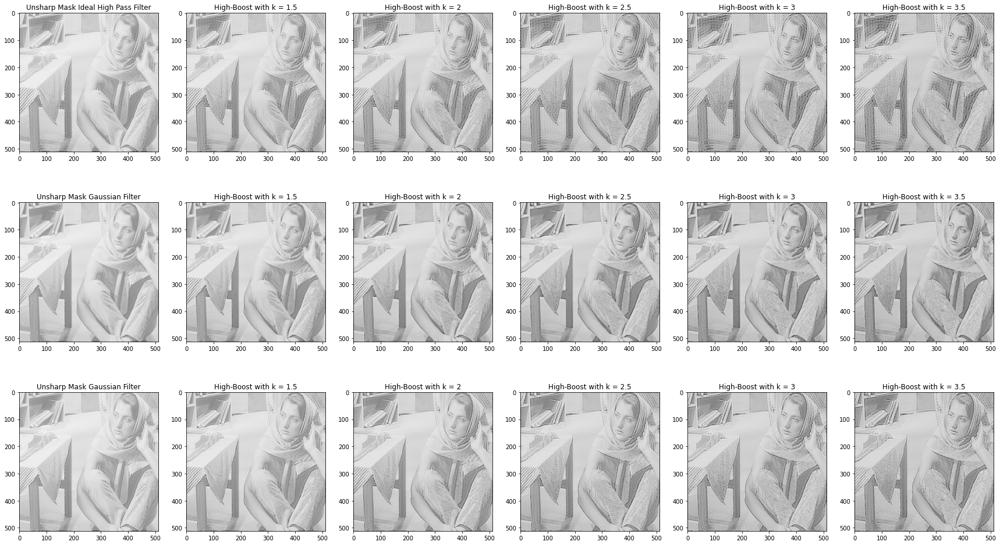

In [ ]:
#Blurred Image
fourierDomain = np.fft.fft2(barbara)
center = np.fft.fftshift(fourierDomain)
highPassCenter = center * idealFilterHP(50, barbara.shape)
highPassCenterG = center * gaussianHP(50, barbara.shape)
highPassCenterB = center * butterworthHP(50, barbara.shape, 3)

#Unsharp Masking and High-Boost
resultIdeal1 = unsharpMaskingFourierHP(center, highPassCenter, 1)
resultIdeal2 = unsharpMaskingFourierHP(center, highPassCenter, 1.5)
resultIdeal3 = unsharpMaskingFourierHP(center, highPassCenter, 2)
resultIdeal4 = unsharpMaskingFourierHP(center, highPassCenter, 2.5)
resultIdeal5 = unsharpMaskingFourierHP(center, highPassCenter, 3)
resultIdeal6 = unsharpMaskingFourierHP(center, highPassCenter, 3.5)

resultG1 = unsharpMaskingFourierHP(center, highPassCenterG, 1)
resultG2 = unsharpMaskingFourierHP(center, highPassCenterG, 1.5)
resultG3 = unsharpMaskingFourierHP(center, highPassCenterG, 2)
resultG4 = unsharpMaskingFourierHP(center, highPassCenterG, 2.5)
resultG5 = unsharpMaskingFourierHP(center, highPassCenterG, 3)
resultG6 = unsharpMaskingFourierHP(center, highPassCenterG, 3.5)

resultB1 = unsharpMaskingFourierHP(center, highPassCenterB, 1)
resultB2 = unsharpMaskingFourierHP(center, highPassCenterB, 1.5)
resultB3 = unsharpMaskingFourierHP(center, highPassCenterB, 2)
resultB4 = unsharpMaskingFourierHP(center, highPassCenterB, 2.5)
resultB5 = unsharpMaskingFourierHP(center, highPassCenterB, 3)
resultB6 = unsharpMaskingFourierHP(center, highPassCenterB, 3.5)

#Plots
plt.figure(figsize=(30, 17), constrained_layout=False)
plt.subplot(3,6,1), plt.imshow(np.log(1+np.abs(resultIdeal1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Ideal High Pass Filter")
plt.subplot(3,6,2), plt.imshow(np.log(1+np.abs(resultIdeal2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,3), plt.imshow(np.log(1+np.abs(resultIdeal3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,4), plt.imshow(np.log(1+np.abs(resultIdeal4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,5), plt.imshow(np.log(1+np.abs(resultIdeal5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,6), plt.imshow(np.log(1+np.abs(resultIdeal6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,7), plt.imshow(np.log(1+np.abs(resultG1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,8), plt.imshow(np.log(1+np.abs(resultG2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,9), plt.imshow(np.log(1+np.abs(resultG3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,10), plt.imshow(np.log(1+np.abs(resultG4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,11), plt.imshow(np.log(1+np.abs(resultG5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,12), plt.imshow(np.log(1+np.abs(resultG6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,13), plt.imshow(np.log(1+np.abs(resultB1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,14), plt.imshow(np.log(1+np.abs(resultB2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,15), plt.imshow(np.log(1+np.abs(resultB3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,16), plt.imshow(np.log(1+np.abs(resultB4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,17), plt.imshow(np.log(1+np.abs(resultB5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,18), plt.imshow(np.log(1+np.abs(resultB6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce31a3050>,
 Text(0.5, 1.0, 'High-Boost with k = 3.5'))

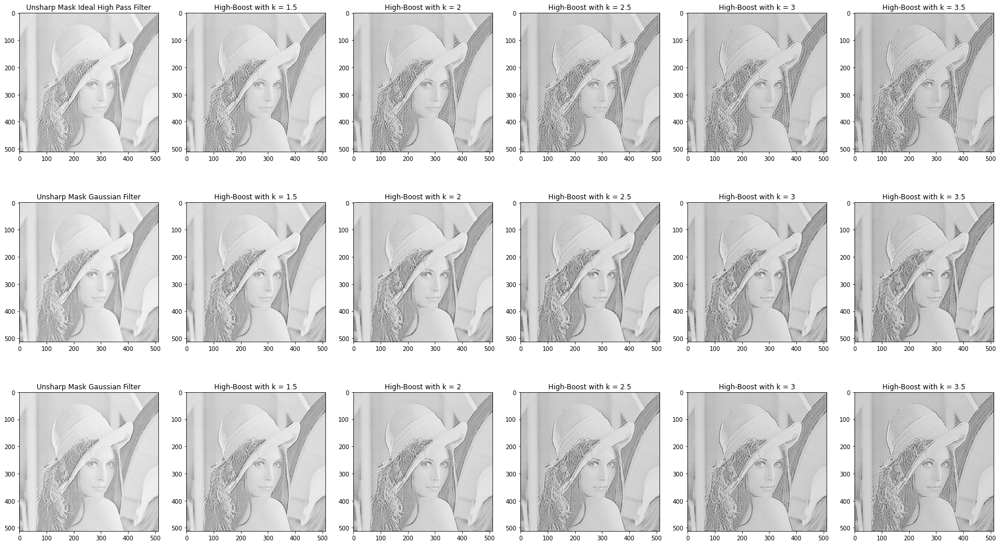

In [ ]:
#Blurred Image
fourierDomain = np.fft.fft2(lena)
center = np.fft.fftshift(fourierDomain)
highPassCenter = center * idealFilterHP(50, lena.shape)
highPassCenterG = center * gaussianHP(50, lena.shape)
highPassCenterB = center * butterworthHP(50, lena.shape, 3)

#Unsharp Masking and High-Boost
resultIdeal1 = unsharpMaskingFourierHP(center, highPassCenter, 1)
resultIdeal2 = unsharpMaskingFourierHP(center, highPassCenter, 1.5)
resultIdeal3 = unsharpMaskingFourierHP(center, highPassCenter, 2)
resultIdeal4 = unsharpMaskingFourierHP(center, highPassCenter, 2.5)
resultIdeal5 = unsharpMaskingFourierHP(center, highPassCenter, 3)
resultIdeal6 = unsharpMaskingFourierHP(center, highPassCenter, 3.5)

resultG1 = unsharpMaskingFourierHP(center, highPassCenterG, 1)
resultG2 = unsharpMaskingFourierHP(center, highPassCenterG, 1.5)
resultG3 = unsharpMaskingFourierHP(center, highPassCenterG, 2)
resultG4 = unsharpMaskingFourierHP(center, highPassCenterG, 2.5)
resultG5 = unsharpMaskingFourierHP(center, highPassCenterG, 3)
resultG6 = unsharpMaskingFourierHP(center, highPassCenterG, 3.5)

resultB1 = unsharpMaskingFourierHP(center, highPassCenterB, 1)
resultB2 = unsharpMaskingFourierHP(center, highPassCenterB, 1.5)
resultB3 = unsharpMaskingFourierHP(center, highPassCenterB, 2)
resultB4 = unsharpMaskingFourierHP(center, highPassCenterB, 2.5)
resultB5 = unsharpMaskingFourierHP(center, highPassCenterB, 3)
resultB6 = unsharpMaskingFourierHP(center, highPassCenterB, 3.5)

#Plots
plt.figure(figsize=(30, 17), constrained_layout=False)
plt.subplot(3,6,1), plt.imshow(np.log(1+np.abs(resultIdeal1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Ideal High Pass Filter")
plt.subplot(3,6,2), plt.imshow(np.log(1+np.abs(resultIdeal2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,3), plt.imshow(np.log(1+np.abs(resultIdeal3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,4), plt.imshow(np.log(1+np.abs(resultIdeal4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,5), plt.imshow(np.log(1+np.abs(resultIdeal5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,6), plt.imshow(np.log(1+np.abs(resultIdeal6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,7), plt.imshow(np.log(1+np.abs(resultG1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,8), plt.imshow(np.log(1+np.abs(resultG2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,9), plt.imshow(np.log(1+np.abs(resultG3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,10), plt.imshow(np.log(1+np.abs(resultG4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,11), plt.imshow(np.log(1+np.abs(resultG5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,12), plt.imshow(np.log(1+np.abs(resultG6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,13), plt.imshow(np.log(1+np.abs(resultB1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,14), plt.imshow(np.log(1+np.abs(resultB2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,15), plt.imshow(np.log(1+np.abs(resultB3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,16), plt.imshow(np.log(1+np.abs(resultB4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,17), plt.imshow(np.log(1+np.abs(resultB5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,18), plt.imshow(np.log(1+np.abs(resultB6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

(<matplotlib.axes._subplots.AxesSubplot at 0x7f7ce2aeb050>,
 Text(0.5, 1.0, 'High-Boost with k = 3.5'))

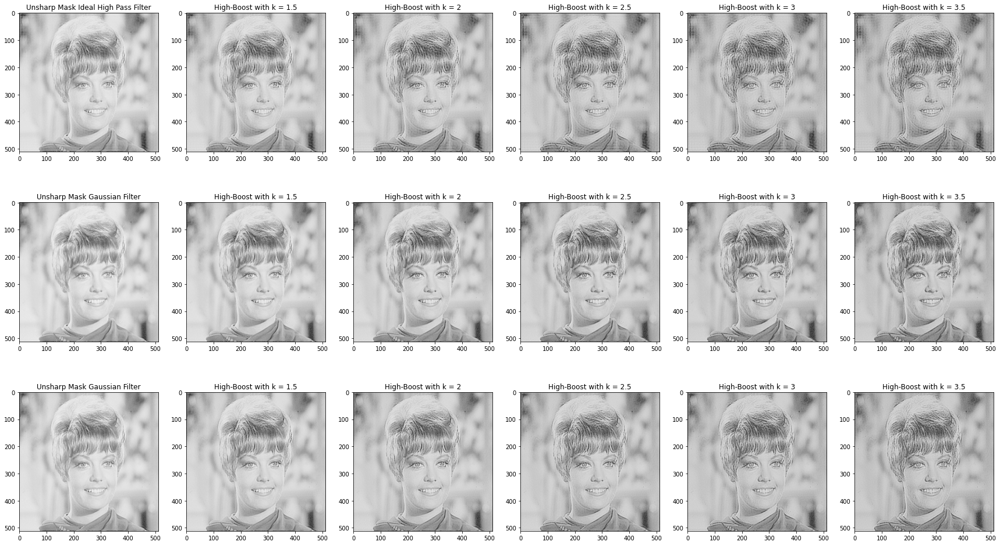

In [ ]:
#Blurred Image
fourierDomain = np.fft.fft2(zelda)
center = np.fft.fftshift(fourierDomain)
highPassCenter = center * idealFilterHP(50, zelda.shape)
highPassCenterG = center * gaussianHP(50, zelda.shape)
highPassCenterB = center * butterworthHP(50, zelda.shape, 3)

#Unsharp Masking and High-Boost
resultIdeal1 = unsharpMaskingFourierHP(center, highPassCenter, 1)
resultIdeal2 = unsharpMaskingFourierHP(center, highPassCenter, 1.5)
resultIdeal3 = unsharpMaskingFourierHP(center, highPassCenter, 2)
resultIdeal4 = unsharpMaskingFourierHP(center, highPassCenter, 2.5)
resultIdeal5 = unsharpMaskingFourierHP(center, highPassCenter, 3)
resultIdeal6 = unsharpMaskingFourierHP(center, highPassCenter, 3.5)

resultG1 = unsharpMaskingFourierHP(center, highPassCenterG, 1)
resultG2 = unsharpMaskingFourierHP(center, highPassCenterG, 1.5)
resultG3 = unsharpMaskingFourierHP(center, highPassCenterG, 2)
resultG4 = unsharpMaskingFourierHP(center, highPassCenterG, 2.5)
resultG5 = unsharpMaskingFourierHP(center, highPassCenterG, 3)
resultG6 = unsharpMaskingFourierHP(center, highPassCenterG, 3.5)

resultB1 = unsharpMaskingFourierHP(center, highPassCenterB, 1)
resultB2 = unsharpMaskingFourierHP(center, highPassCenterB, 1.5)
resultB3 = unsharpMaskingFourierHP(center, highPassCenterB, 2)
resultB4 = unsharpMaskingFourierHP(center, highPassCenterB, 2.5)
resultB5 = unsharpMaskingFourierHP(center, highPassCenterB, 3)
resultB6 = unsharpMaskingFourierHP(center, highPassCenterB, 3.5)

#Plots
plt.figure(figsize=(30, 17), constrained_layout=False)
plt.subplot(3,6,1), plt.imshow(np.log(1+np.abs(resultIdeal1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Ideal High Pass Filter")
plt.subplot(3,6,2), plt.imshow(np.log(1+np.abs(resultIdeal2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,3), plt.imshow(np.log(1+np.abs(resultIdeal3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,4), plt.imshow(np.log(1+np.abs(resultIdeal4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,5), plt.imshow(np.log(1+np.abs(resultIdeal5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,6), plt.imshow(np.log(1+np.abs(resultIdeal6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,7), plt.imshow(np.log(1+np.abs(resultG1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,8), plt.imshow(np.log(1+np.abs(resultG2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,9), plt.imshow(np.log(1+np.abs(resultG3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,10), plt.imshow(np.log(1+np.abs(resultG4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,11), plt.imshow(np.log(1+np.abs(resultG5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,12), plt.imshow(np.log(1+np.abs(resultG6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

plt.subplot(3,6,13), plt.imshow(np.log(1+np.abs(resultB1)), cmap=plt.cm.gray), plt.title("Unsharp Mask Gaussian Filter")
plt.subplot(3,6,14), plt.imshow(np.log(1+np.abs(resultB2)), cmap=plt.cm.gray), plt.title("High-Boost with k = 1.5")
plt.subplot(3,6,15), plt.imshow(np.log(1+np.abs(resultB3)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2")
plt.subplot(3,6,16), plt.imshow(np.log(1+np.abs(resultB4)), cmap=plt.cm.gray), plt.title("High-Boost with k = 2.5")
plt.subplot(3,6,17), plt.imshow(np.log(1+np.abs(resultB5)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3")
plt.subplot(3,6,18), plt.imshow(np.log(1+np.abs(resultB6)), cmap=plt.cm.gray), plt.title("High-Boost with k = 3.5")

>>>
* Para o caso do passa-alta, a medida que se aumenta o valor de $k$, da para ver mais detalhes nas imagens utilizadas, e novamente elas escurecem, porém menos que no passa-baixa. 
* O filtro ideal tem um pior desempenho, pois parece borrar as imagens, assim como no passa-baixa.